# PROJECT-5. Задача регрессии

Александр Журавлев DST-120
***
***

# Этап №1
- предварительный анализ и обработка данных
- EDA + FE
- сохранение обработанных данных

***
***

## 1. Постановка задачи

<center> <img src=https://storage.googleapis.com/kaggle-competitions/kaggle/3333/media/taxi_meter.png align="right" width="300"/> </center>
    
Вам предстоит решить настоящую задачу машинного обучения, направленную на автоматизацию бизнес процессов. Мы построим модель, которая будет предсказывать общую продолжительность поездки такси в Нью-Йорке. 

Представьте вы заказываете такси из одной точки Нью-Йорка в другую, причем не обязательно конечная точка должна находиться в пределах города. Сколько вы должны будете за нее заплатить? Известно, что стоимость такси в США  рассчитывается на основе фиксированной ставки + тарифная стоимость, величина которой зависит от времени и расстояния. Тарифы варьируются в зависимости от города.

В свою очередь время поездки зависит от множества факторов таких как, откуда и куда вы едете, в какое время суток вы совершаете вашу поездку, погодных условий и так далее. 

Таким образом, если мы разработаем алгоритм, способный определять длительность поездки, мы сможем прогнозировать ее стоимость самым тривиальным образом, например, просто умножая стоимость на заданный тариф. 
Сервисы такси хранят огромные объёмы информации о поездках, включая такие данные как конечная, начальная точка маршрута, дата поездки и ее длительность. Эти данные можно использовать для того, чтобы прогнозировать длительность поездки в автоматическом режиме с привлечением искусственного интеллекта.

**Бизнес-задача:** определить характеристики и с их помощью спрогнозировать длительность поездки такси.

**Техническая задача для вас как для специалиста в Data Science:** построить модель машинного обучения, которая на основе предложенных характеристик клиента будет предсказывать числовой признак - время поездки такси. То есть решить задачу регрессии.

**Основные цели проекта:**
1. Сформировать набор данных на основе нескольких источников информации
2. Спроектировать новые признаки с помощью Feature Engineering и выявить наиболее значимые при построении модели
3. Исследовать предоставленные данные и выявить закономерности
4. Построить несколько моделей и выбрать из них наилучшую по заданной метрике
5. Спроектировать процесс предсказания времени длительности поездки для новых данных

Загрузить свое решение на платформу Kaggle, тем самым поучаствовав в настоящем Data Science соревновании.
Во время выполнения проекта вы отработаете навыки работы с несколькими источниками данных, генерации признаков, разведывательного анализа и визуализации данных, отбора признаков и, конечно же, построения моделей машинного обучения!


***
***

## 2. Знакомство с данными, базовый анализ и расширение данных

Начнём наше исследование со знакомства с предоставленными данными. А также подгрузим дополнительные источники данных и расширим наш исходный датасет. 


Заранее импортируем модули, которые нам понадобятся для решения задачи:

In [1]:
# импортируем необходимые библиотеки

# для работы с данными и вычислений
import numpy as np
import pandas as pd

# объект Counter
from collections import Counter

# для статистических исследований
from scipy.stats import normaltest, shapiro

# для визуализации
import matplotlib.pyplot as plt
import seaborn as sns
# настройка визуализации
%matplotlib inline
plt.style.use('seaborn-v0_8')
%config InlineBackend.figure_format = "retina"

# не отображаем предупреждения
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

# импортируем собственные функции
from my_functions import *

Прочитаем наш файл с исходными данными:

In [2]:
# загружаем исходные данные
taxi_data = pd.read_csv("data/train.csv")
# сохраним изначальную размерность данных
initial_shape = taxi_data.shape
# выводим основную информацию по исходным данным
print('Train data shape: {}'.format(initial_shape))
taxi_data.head()

Train data shape: (1458644, 11)


,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


Итак, у нас есть данные о почти 1.5 миллионах поездок и 11 характеристиках, которые описывают каждую из поездок. 

**Данные о клиенте и таксопарке:**
* **id** - уникальный идентификатор поездки
* **vendor_id** - уникальный идентификатор поставщика (таксопарка), связанного с записью поездки

**Временные характеристики:**
* **pickup_datetime** - дата и время, когда был включен счетчик поездки
* **dropoff_datetime** - дата и время, когда счетчик был отключен

**Географическая информация:**
* **pickup_longitude** -  долгота, на которой был включен счетчик
* **pickup_latitude** - широта, на которой был включен счетчик
* **dropoff_longitude** - долгота, на которой счетчик был отключен
* **dropoff_latitude** - широта, на которой счетчик был отключен

**Прочие признаки:**
* **passenger_count** - количество пассажиров в транспортном средстве (введенное водителем значение)
* **store_and_fwd_flag** - флаг, который указывает, сохранилась ли запись о поездке в памяти транспортного средства перед отправкой поставщику. Y - хранить и пересылать, N - не хранить и не пересылать поездку.

**Целевой признак:**
* **trip_duration** - продолжительность поездки в секундах


***

### 2.1. Основная информация по исходным данным

In [3]:
# общая информация по исходным данным
taxi_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 11 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1458644 non-null  object 
 1   vendor_id           1458644 non-null  int64  
 2   pickup_datetime     1458644 non-null  object 
 3   dropoff_datetime    1458644 non-null  object 
 4   passenger_count     1458644 non-null  int64  
 5   pickup_longitude    1458644 non-null  float64
 6   pickup_latitude     1458644 non-null  float64
 7   dropoff_longitude   1458644 non-null  float64
 8   dropoff_latitude    1458644 non-null  float64
 9   store_and_fwd_flag  1458644 non-null  object 
 10  trip_duration       1458644 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 122.4+ MB


In [4]:
# ищем явные пропуски
print(f'Количество явных пропусков в данных:\n\n{taxi_data.isnull().sum()}\n\n')

Количество явных пропусков в данных:

id                    0
vendor_id             0
pickup_datetime       0
dropoff_datetime      0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
trip_duration         0
dtype: int64




In [5]:
# поиск дубликатов
print(f'Число найденных дубликатов: {taxi_data[taxi_data.duplicated()].shape[0]}')

Число найденных дубликатов: 0


In [6]:
# общая информация по признакам
display(taxi_data.describe().T)
display(taxi_data.describe(include='object').T)
print(f'\nКоличество уникальных значений:\n\n{taxi_data.nunique()}')

,count,mean,std,min,25%,50%,75%,max
vendor_id,1458644.0,1.534950,0.498777,1.000000,1.000000,2.000000,2.000000,2.000000e+00
passenger_count,1458644.0,1.664530,1.314242,0.000000,1.000000,1.000000,2.000000,9.000000e+00
pickup_longitude,1458644.0,-73.973486,0.070902,-121.933342,-73.991867,-73.981743,-73.967331,-6.133553e+01
pickup_latitude,1458644.0,40.750921,0.032881,34.359695,40.737347,40.754101,40.768360,5.188108e+01
dropoff_longitude,1458644.0,-73.973416,0.070643,-121.933304,-73.991325,-73.979752,-73.963013,-6.133553e+01
dropoff_latitude,1458644.0,40.751800,0.035891,32.181141,40.735885,40.754524,40.769810,4.392103e+01
trip_duration,1458644.0,959.492273,5237.431724,1.000000,397.000000,662.000000,1075.000000,3.526282e+06


,count,unique,top,freq
id,1458644,1458644,id2875421,1
pickup_datetime,1458644,1380222,2016-03-04 08:07:34,5
dropoff_datetime,1458644,1380377,2016-02-19 19:25:04,5
store_and_fwd_flag,1458644,2,N,1450599



Количество уникальных значений:

id                    1458644
vendor_id                   2
pickup_datetime       1380222
dropoff_datetime      1380377
passenger_count            10
pickup_longitude        23047
pickup_latitude         45245
dropoff_longitude       33821
dropoff_latitude        62519
store_and_fwd_flag          2
trip_duration            7417
dtype: int64


**Выводы общие по исходным данным:**
- в датасете имеются данные почти о 1.5млн поездках на такси
- каждая поездка характеризуется 11 признаками
- в данных отсутствуют явные пропуски и дубликаты

**Выводы по признакам датасета:**
- **id** - номинальный категориальный признак, который уникален для каждой поездки
- **vendor_id** - номинальный категориальный признак, который говорит нам о том, что использовались данные о поездках только 2-х таксопарков Нью-Йорка. Интересно, что по данным из открытых источников, в 2016 году в Нью-Йорке таксисты осуществили 92,5 млн поездок. В то же время известно, что в 2015 году в городе насчитывалось 13.581 такси, что составляет один из самых больших таксопарков в мире. Таким образом, мы имеем дело лишь с малой долей выполненных поездок и только у 2-х таксопарков.
- **pickup_datetime** и **dropoff_datetime** необходимо приводить к типу *datetime* и уже дальше подробнее разбираться. Признак **dropoff_datetime** явно ответственен за утечку данных, ведь мы заранее не будем знать, когда закончится поездка (выключится счетчик) и, соответственно, не можем знать продолжительность поездки.
- **passenger_count** - дискретный числовой признак (хотя, возможно, категориальный). Имеет 10 уникальных значений, но чаще всего перевозили 1 пассажира (или 1-2, если брать межквартильный размах). В то же время минимальное значение признака = 0, что явно является аномалией. Максимальное значение = 9. Интересно, 9 человек поместятся в такси?     
Погуглив, нашел следующую официальную информацию: Максимальное количество пассажиров, разрешенное законом в желтом такси, составляет четыре (4) человека в такси с четырьмя (4) пассажирами или пять (5) пассажиров в такси с пятью (5) пассажирами, за исключением того, что дополнительный пассажир должен быть принят, если такой пассажир младше семи (7) лет и держится на коленях взрослого пассажира, сидящего сзади. ([ссылка](https://www.nyc.gov/site/tlc/passengers/passenger-frequently-asked-questions.page))     
Если предположить, что такси на 5 пассажиров везет 5 взрослых + 4 детей (на коленях у 4-х взрослых сзади), то в принципе это может быть нормальным значением.
- по признакам координат видно, что по долготе в обоих случаях явно будут выбросы (разброс в 60 градусов слишком большой), да и по широте, вероятно, тоже.
- **store_and_fwd_flag** - бинарный категориальный признак. В подавляющем большинстве данные не хранились и не пересылались.
- **trip_duration** (целевая переменная) - непрерывный числовой признак, хотя уникальных значений немного (примерно 7.5тыс на 1.5млн. записей). Явно содержит выбросы.

***

**Загрузим тестовые данные**

In [7]:
# загрузим тестовые данные
test_data = pd.read_csv('data/Project5_test_data.csv')
test_data.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag
0,id3004672,1,2016-06-30 23:59:58,1,-73.988129,40.732029,-73.990173,40.756680,N
1,id3505355,1,2016-06-30 23:59:53,1,-73.964203,40.679993,-73.959808,40.655403,N
2,id1217141,1,2016-06-30 23:59:47,1,-73.997437,40.737583,-73.986160,40.729523,N
3,id2150126,2,2016-06-30 23:59:41,1,-73.956070,40.771900,-73.986427,40.730469,N
4,id1598245,1,2016-06-30 23:59:33,1,-73.970215,40.761475,-73.961510,40.755890,N


В тестовых данных отсутствует целевая переменная **trip_duration**, что логично, однако стоит обратить внимание на отсутствие признака **dropoff_datetime**.

***

### 2.2. Приводим признаки **pickup_datetime** и **dropoff_datetime** к типу *datetime*, анализируем и создаем новые признаки на основе дат

In [8]:
# переводим признак pickup_datetime в тип данных datetime
taxi_data['pickup_datetime'] = pd.to_datetime(taxi_data['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
# выводим минимальное и максимальное значения признака
print(taxi_data['pickup_datetime'].min())
print(taxi_data['pickup_datetime'].max())

2016-01-01 00:00:17
2016-06-30 23:59:39


Мы имеем дело с даными за первое полугодие 2016 года.

In [9]:
# переводим признак dropoff_datetime в тип данных datetime
taxi_data['dropoff_datetime'] = pd.to_datetime(taxi_data['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
# выводим минимальное и максимальное значения признака
print(taxi_data['dropoff_datetime'].min())
print(taxi_data['dropoff_datetime'].max())

2016-01-01 00:03:31
2016-07-01 23:02:03


Интересно, что окончание последней поездки сместилось на поздний вечер 1-го июля.

Мы уже поняли, что признак **dropoff_datetime** вызывает утечку данных. Мне интересно узнать: если мы вычтем из даты окончания поездки дату начала, то получим ли мы те же цифры, что и в признаке **trip_duration** или нет?

In [10]:
# создадим признак, где будет разница в секундах между выключением и включением счетчика
taxi_data['delta_time'] = (taxi_data['dropoff_datetime'] - taxi_data['pickup_datetime']).dt.seconds
# создадим еще один признак, где будет разница между длительностью поездки в признаках
# trip_duration и delta_time
taxi_data['duration_equal_or_not'] = taxi_data['trip_duration'] - taxi_data['delta_time']
taxi_data['duration_equal_or_not'].value_counts()

0          1458640
1900800          1
1987200          1
2160000          1
3456000          1
Name: duration_equal_or_not, dtype: int64

Так, длительность поездок одинаковая (разность равна нулю). Правда, мы имеем 3 поездки, где значение признака **trip_duration** на 1 секунду превышает длительность поездки, которую мы вычислили вручную. Однако полагаю, что данной аномалией можно спокойно пренебречь. Удалим созданные для анализа признаки, признак **dropoff_datetime** также удаляем (предотвращаем утечку данных).

In [11]:
# удаляем уже ненужные признаки
taxi_data.drop(['delta_time', 'duration_equal_or_not','dropoff_datetime'], axis=1, inplace=True)

Преобразуем данные с помощью функции **add_datetime_features**, которая принимает на вход датафрейм и преобразует признаки даты/времени в 
отдельные признаки даты, часа и дня недели, когда был включен счетчик; удаляет старые признаки даты включения и выключения счетчика.

In [12]:
# создаем новые признаки и удаляем исходные признаки дат
add_datetime_features(taxi_data)

,id,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,pickup_date,pickup_hour,pickup_day_of_week
0,id2875421,2,1,-73.982155,40.767937,-73.964630,40.765602,N,455,2016-03-14,17,0
1,id2377394,1,1,-73.980415,40.738564,-73.999481,40.731152,N,663,2016-06-12,0,6
2,id3858529,2,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,2016-01-19,11,1
3,id3504673,2,1,-74.010040,40.719971,-74.012268,40.706718,N,429,2016-04-06,19,2
4,id2181028,2,1,-73.973053,40.793209,-73.972923,40.782520,N,435,2016-03-26,13,5
...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,4,-73.982201,40.745522,-73.994911,40.740170,N,778,2016-04-08,13,4
1458640,id1049543,1,1,-74.000946,40.747379,-73.970184,40.796547,N,655,2016-01-10,7,6
1458641,id2304944,2,1,-73.959129,40.768799,-74.004433,40.707371,N,764,2016-04-22,6,4
1458642,id2714485,1,1,-73.982079,40.749062,-73.974632,40.757107,N,373,2016-01-05,15,1


Повторим эти преобразования с тестовой выборкой.

In [13]:
# повторим эти преобразования с тестовой выборкой
test_data['pickup_datetime'] = pd.to_datetime(test_data['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
add_datetime_features(test_data)

,id,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,pickup_date,pickup_hour,pickup_day_of_week
0,id3004672,1,1,-73.988129,40.732029,-73.990173,40.756680,N,2016-06-30,23,3
1,id3505355,1,1,-73.964203,40.679993,-73.959808,40.655403,N,2016-06-30,23,3
2,id1217141,1,1,-73.997437,40.737583,-73.986160,40.729523,N,2016-06-30,23,3
3,id2150126,2,1,-73.956070,40.771900,-73.986427,40.730469,N,2016-06-30,23,3
4,id1598245,1,1,-73.970215,40.761475,-73.961510,40.755890,N,2016-06-30,23,3
...,...,...,...,...,...,...,...,...,...,...,...
625129,id3008929,1,1,-74.003464,40.725105,-74.001251,40.733643,N,2016-01-01,0,4
625130,id3700764,1,1,-74.006363,40.743782,-73.953407,40.782467,N,2016-01-01,0,4
625131,id2568735,1,2,-73.972267,40.759865,-73.876602,40.748665,N,2016-01-01,0,4
625132,id1384355,1,1,-73.976501,40.733562,-73.854263,40.891788,N,2016-01-01,0,4


***

### 2.3. Добавим данные о праздниках за период поездок на такси

In [14]:
# загружаем данные о праздничных днях
holiday_data = pd.read_csv('data/holiday_data.csv', sep=';')

Применим к нашим данным функцию **add_holiday_features**, которая объединит исходные данные с таблицей праздников в 2016 году и создаст бинарный признак **pickup_holiday**, который укажет был ли день включения счетчика праздничным (значение=1) или нет (значение=0).

In [15]:
# добавляем признак pickup_holiday - является ли день поездки праздником
taxi_data = add_holiday_features(taxi_data, holiday_data)

Повторим эти преобразования с тестовой выборкой.

In [16]:
# повторим эти преобразования с тестовой выборкой.
test_data = add_holiday_features(test_data, holiday_data)

***

### 2.4. Добавим OSRM-данные

In [17]:
# загружаем OSRM-данные
osrm_data = pd.read_csv('data/osrm_data_train.csv')
# изучим загруженный датасет
osrm_data.head()

,id,starting_street,end_street,total_distance,total_travel_time,number_of_steps,street_for_each_step,distance_per_step,travel_time_per_step,step_maneuvers,step_direction,step_location_list
0,id2875421,Columbus Circle,East 65th Street,2009.1,164.9,5,Columbus Circle|Central Park West|65th Street ...,0|576.4|885.6|547.1|0,0|61.1|60.1|43.7|0,depart|rotary|turn|new name|arrive,left|straight|right|straight|arrive,"-73.982316,40.767869|-73.981997,40.767688|-73...."
1,id2377394,2nd Avenue,Washington Square West,2513.2,332.0,6,2nd Avenue|East 13th Street|5th Avenue|Washing...,877.3|836.5|496.1|164.2|139.1|0,111.7|109|69.9|25.8|15.6|0,depart|turn|turn|end of road|continue|arrive,none|right|left|right|left|arrive,"-73.980429,40.73857|-73.985444,40.731658|-73.9..."
2,id3504673,Greenwich Street,Broadway,1779.4,235.8,4,Greenwich Street|Park Place|Broadway|Broadway,644.2|379.9|755.3|0,80.5|50.8|104.5|0,depart|turn|end of road|arrive,left|left|right|arrive,"-74.010145,40.719982|-74.011527,40.714294|-74...."
3,id2181028,Broadway,West 81st Street,1614.9,140.1,5,Broadway|West 86th Street|Columbus Avenue|West...,617|427.4|412.2|158.3|0,56|36|37.8|10.3|0,depart|turn|turn|turn|arrive,right|left|right|left|arrive,"-73.972998,40.793187|-73.976607,40.788361|-73...."
4,id0801584,Lexington Avenue,West 31st Street,1393.5,189.4,5,Lexington Avenue|East 27th Street|Madison Aven...,18.9|311.9|313.3|749.4|0,6.3|42.9|48.4|91.8|0,depart|turn|turn|turn|arrive,right|right|right|left|arrive,"-73.982805,40.742173|-73.982914,40.742024|-73...."


Из данного датасета можно вынуть следующие полезные признаки: **id**,**total_distance**, **total_travel_time**, **number_of_steps**.    
Однако, не только эти.    
Любому автолюбителю известно, что каждые маневр занимает определенное время и влияет на скорость движения автомобиля. Например, поворот налево занимает больше времени, чем направо (нужно ждать, когда загорится стрелка поворота в дополнительной секции или пропускать встречные машины). Мы можем использовать еще и признаки **step_maneuvers** и **step_direction**.

Обновим датасет OSRM.

In [18]:
# оставляем только необходимые нам данные 
osrm_data = osrm_data[['id','total_distance', 'total_travel_time', 'number_of_steps', 'step_maneuvers', 'step_direction']]

Проработаем признак **step_maneuvers**, выделив из него уникальные значения в отдельные признаки.

In [19]:
# множество, где будут все уникальные значения признака step_maneuvers
# для создания новых признаков в датасете
new_features_from_step_maneuvers = set()

def get_step_maneuvers(x):
    '''
    Функция принимает на вход признак step_maneuvers, выделяет его
    значения и возвращает словарь в виде значение:количество.
    Аргумент функции:
        x: значение признака step_maneuvers в виде строки
    Функция возвращает:
        x_dict: словарь вида значение:количество
    '''
    # соберем в отдельный список все значения признака step_maneuvers
    step_maneuvers_list = []
    # разделяем признак на отдельные значения в виде промежуточного списка
    x_list = x.split('|')

    # проходимся по промежуточному списку значений
    for i in range(len(x_list)):
        # не учитываем значения 'отправление' и  'прибытие'
        if x_list[i] not in ['depart', 'arrive']: 
            # добавим значение признака в отдельный список 
            step_maneuvers_list.append(x_list[i])
            # добавим значение признака в множество с новыми признаками для датасета
            new_features_from_step_maneuvers.add(x_list[i])
    
    # преобразуем отдельный список в объект Counter, что бы узнать количество каждого из значений
    x_counter = Counter(step_maneuvers_list)
    # преобразуем объект Counter в обычный словарь и возвращаем его
    x_dict = dict(x_counter)

    return x_dict

# применяем функцию get_step_maneuvers к датасету, 
# заменив строковые значения признака step_maneuvers на словарь вида значение:количество
osrm_data['step_maneuvers'] = osrm_data['step_maneuvers'].apply(get_step_maneuvers)

# создаем новые признаки в датасете, заполнив их по умолчанию нулями
for feature in new_features_from_step_maneuvers:
    osrm_data[feature] = 0

# заполняем новые признаки количеством их значений 
for feature in new_features_from_step_maneuvers:
    osrm_data[feature] = osrm_data['step_maneuvers'].apply(lambda x: x[feature] if feature in x else 0)

Проработаем признак **step_direction**, выделив из него уникальные значения в отдельные признаки.

In [20]:
# множество, где будут все уникальные значения признака step_direction
# для создания новых признаков в датасете
new_features_from_step_direction = set()

def get_step_direction(x):
    '''
    Функция принимает на вход признак step_direction, выделяет его
    значения и возвращает словарь в виде значение:количество.
    Аргумент функции:
        x: значение признака step_direction в виде строки
    Функция возвращает:
        x_dict: словарь вида значение:количество
    '''
    # соберем в отдельный список все значения признака step_direction
    step_direction_list = []
    # разделяем признак на отдельные значения в виде промежуточного списка
    x_list = x.split('|')

    # проходимся по промежуточному списку значений
    for i in range(len(x_list)):
        # не учитываем значения 'отправление' и  'прибытие'
        if x_list[i] not in ['depart', 'arrive']:
            # добавим значение признака в отдельный список 
            step_direction_list.append(x_list[i])
            # добавим значение признака в множество с новыми признаками для датасета
            new_features_from_step_direction.add(x_list[i])
    
    # преобразуем отдельный список в объект Counter, что бы узнать количество каждого из значений
    x_counter = Counter(step_direction_list)
    # преобразуем объект Counter в обычный словарь и возвращаем его
    x_dict = dict(x_counter)

    return x_dict

# применяем функцию get_step_directio к датасету, 
# заменив строковые значения признака step_direction на словарь вида значение:количество
osrm_data['step_direction'] = osrm_data['step_direction'].apply(get_step_direction)

# создаем новые признаки в датасете, заполнив их по умолчанию нулями
for feature in new_features_from_step_direction:
    osrm_data[feature] = 0

# заполняем новые признаки количеством их значений 
for feature in new_features_from_step_direction:
    osrm_data[feature] = osrm_data['step_direction'].apply(lambda x: x[feature] if feature in x else 0)

Удаляем ненужные признаки

In [21]:
# удалим признаки step_maneuvers и step_direction
osrm_data.drop(['step_maneuvers', 'step_direction'], axis=1, inplace=True)

In [22]:
# применим функцию add_osrm_features для объединения исходных данных и OSRM-данных
taxi_data = add_osrm_features(taxi_data, osrm_data)

Повторим эти преобразования с тестовой выборкой.

In [23]:
# повторим эти преобразования с тестовой выборкой.

# загрузим OSRM-данные для тестовой выборки
osrm_data_test = pd.read_csv('data/Project5_osrm_data_test.csv')
# оставляем только необходимые нам данные 
osrm_data_test = osrm_data_test[['id','total_distance', 'total_travel_time', 'number_of_steps', 'step_maneuvers', 'step_direction']]


# преобразуем загруженные данные, как выше

# применяем функцию get_step_maneuvers к датасету, 
# заменив строковые значения признака step_maneuvers на словарь вида значение:количество
osrm_data_test['step_maneuvers'] = osrm_data_test['step_maneuvers'].apply(get_step_maneuvers)

# создаем новые признаки в датасете, заполнив их по умолчанию нулями
for feature in new_features_from_step_maneuvers:
    osrm_data_test[feature] = 0

# заполняем новые признаки количеством их значений 
for feature in new_features_from_step_maneuvers:
    osrm_data_test[feature] = osrm_data_test['step_maneuvers'].apply(lambda x: x[feature] if feature in x else 0)


# применяем функцию get_step_direction к датасету, 
# заменив строковые значения признака step_direction на словарь вида значение:количество
osrm_data_test['step_direction'] = osrm_data_test['step_direction'].apply(get_step_direction)

# создаем новые признаки в датасете, заполнив их по умолчанию нулями
for feature in new_features_from_step_direction:
    osrm_data_test[feature] = 0

# заполняем новые признаки количеством их значений 
for feature in new_features_from_step_direction:
    osrm_data_test[feature] = osrm_data_test['step_direction'].apply(lambda x: x[feature] if feature in x else 0)


# удалим признаки step_maneuvers и step_direction
osrm_data_test.drop(['step_maneuvers', 'step_direction'], axis=1, inplace=True)

# применим функцию add_osrm_features для объединения исходных данных и OSRM-данных
test_data = add_osrm_features(test_data, osrm_data_test)

***

### 2.5. Добавим географические данные

Добавим в наш датасет еще 2 признака: 
- **haversine_distance** - расстояние Хаверсина и
- **direction** - направление движения из точки, где счетчик был включен, в точку, где он был выключен

In [24]:
# используя функцию add_geographical_features добавляем новые признаки 
# haversine_distance (расстояние Хаверсина) и direction (направление движения) в рабочий датасет 
add_geographical_features(taxi_data)
# повтряем для тестовой выборки
add_geographical_features(test_data)

,id,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,pickup_date,pickup_hour,...,none,slight right,sharp right,uturn,straight,sharp left,right,slight left,haversine_distance,direction
0,id3004672,1,1,-73.988129,40.732029,-73.990173,40.756680,N,2016-06-30,23,...,1,0,0,0,0,0,1,0,2.746426,-3.595224
1,id3505355,1,1,-73.964203,40.679993,-73.959808,40.655403,N,2016-06-30,23,...,1,0,0,0,0,0,1,0,2.759239,172.278835
2,id1217141,1,1,-73.997437,40.737583,-73.986160,40.729523,N,2016-06-30,23,...,1,0,0,0,0,0,1,0,1.306155,133.326248
3,id2150126,2,1,-73.956070,40.771900,-73.986427,40.730469,N,2016-06-30,23,...,1,1,0,0,1,0,3,1,5.269088,-150.956833
4,id1598245,1,1,-73.970215,40.761475,-73.961510,40.755890,N,2016-06-30,23,...,0,0,0,0,0,0,1,0,0.960842,130.260381
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
625129,id3008929,1,1,-74.003464,40.725105,-74.001251,40.733643,N,2016-01-01,0,...,1,1,0,0,0,0,2,0,0.967438,11.110268
625130,id3700764,1,1,-74.006363,40.743782,-73.953407,40.782467,N,2016-01-01,0,...,0,1,0,0,5,0,2,0,6.196343,46.018484
625131,id2568735,1,2,-73.972267,40.759865,-73.876602,40.748665,N,2016-01-01,0,...,0,1,0,0,2,0,4,2,8.153719,98.754367
625132,id1384355,1,1,-73.976501,40.733562,-73.854263,40.891788,N,2016-01-01,0,...,1,1,0,0,3,0,6,3,20.380748,30.275237


Повторим эти преобразования с тестовой выборкой.

In [25]:
# повторим эти преобразования с тестовой выборкой.
add_geographical_features(test_data)

,id,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,pickup_date,pickup_hour,...,none,slight right,sharp right,uturn,straight,sharp left,right,slight left,haversine_distance,direction
0,id3004672,1,1,-73.988129,40.732029,-73.990173,40.756680,N,2016-06-30,23,...,1,0,0,0,0,0,1,0,2.746426,-3.595224
1,id3505355,1,1,-73.964203,40.679993,-73.959808,40.655403,N,2016-06-30,23,...,1,0,0,0,0,0,1,0,2.759239,172.278835
2,id1217141,1,1,-73.997437,40.737583,-73.986160,40.729523,N,2016-06-30,23,...,1,0,0,0,0,0,1,0,1.306155,133.326248
3,id2150126,2,1,-73.956070,40.771900,-73.986427,40.730469,N,2016-06-30,23,...,1,1,0,0,1,0,3,1,5.269088,-150.956833
4,id1598245,1,1,-73.970215,40.761475,-73.961510,40.755890,N,2016-06-30,23,...,0,0,0,0,0,0,1,0,0.960842,130.260381
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
625129,id3008929,1,1,-74.003464,40.725105,-74.001251,40.733643,N,2016-01-01,0,...,1,1,0,0,0,0,2,0,0.967438,11.110268
625130,id3700764,1,1,-74.006363,40.743782,-73.953407,40.782467,N,2016-01-01,0,...,0,1,0,0,5,0,2,0,6.196343,46.018484
625131,id2568735,1,2,-73.972267,40.759865,-73.876602,40.748665,N,2016-01-01,0,...,0,1,0,0,2,0,4,2,8.153719,98.754367
625132,id1384355,1,1,-73.976501,40.733562,-73.854263,40.891788,N,2016-01-01,0,...,1,1,0,0,3,0,6,3,20.380748,30.275237


***

### 2.6. Добавим погодные условия

In [26]:
# загружаем данные с погодой
weather_data = pd.read_csv('data/weather_data.csv')

# переименовываем колонки в загруженных данных для последующего объединения по ним
weather_data.rename(columns={'date': 'pickup_date', 'hour': 'pickup_hour'}, inplace=True)
# переводим признак pickup_date в формат datetime
weather_data['pickup_date'] = pd.to_datetime(weather_data['pickup_date'], format='%Y-%m-%d')
# оставляем только необходимые для нас данные
weather_data = weather_data[['temperature', 'visibility', 'wind speed', 'precip', 'events', 'pickup_date', 'pickup_hour']]

Используя функцию **add_weather_features**, добавим в исходные данные информацию о погоде на час включения счетчика (температура, видимость, скорость ветра, влажность, погодные события)

In [27]:
# объединяем исходный датасет с погодным
taxi_data = add_weather_features(taxi_data, weather_data)

Используя функцию **fill_null_weather_data**, заполним пропуски в данных.

In [28]:
# заполняем пропуски с данными о поездках
taxi_data = fill_null_weather_data(taxi_data)

Повторим эти преобразования с тестовой выборкой.

In [29]:
# повторим эти преобразования с тестовой выборкой.
test_data = add_weather_features(test_data, weather_data)
test_data = fill_null_weather_data(test_data)

***

### 2.7. Ищем оставшиеся пропуски

In [30]:
taxi_data.isnull().sum().sum()

20

In [31]:
# сколько строк с пропущенными значениями
taxi_data[taxi_data.isna().any(axis=1)]

,id,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,pickup_date,...,sharp left,right,slight left,haversine_distance,direction,temperature,visibility,wind speed,precip,events
1133561,id3008062,2,1,-73.787537,40.64241,-73.787811,40.642109,N,26,2016-06-23,...,NaN,NaN,NaN,0.040742,-145.333864,25.6,12.9,0.0,0.0,None


У нас одна строка с 20 пропусками - удалим ее.

In [32]:
print(f'Размернсть датасета до удаления пропусков: {taxi_data.shape}')
taxi_data = taxi_data.drop(index=1133561)
print(f'Размернсть датасета после удаления пропусков: {taxi_data.shape}')

Размернсть датасета до удаления пропусков: (1458644, 43)
Размернсть датасета после удаления пропусков: (1458643, 43)


Проверим наличие пропусков на тестовой выборке.

In [33]:
test_data.isnull().sum().sum()

0

***

### 2.8. Удаляем явные аномалии и выбросы

- исследуем аномалии в длительности поездок, сокрости поездок, расстоянии на которое переместилось такси

Рассмотрим явные аномалии и выбросы в признаке **trip_duration**.
Будем считать, что длительность поездки более 1 суток - явная аномалия.

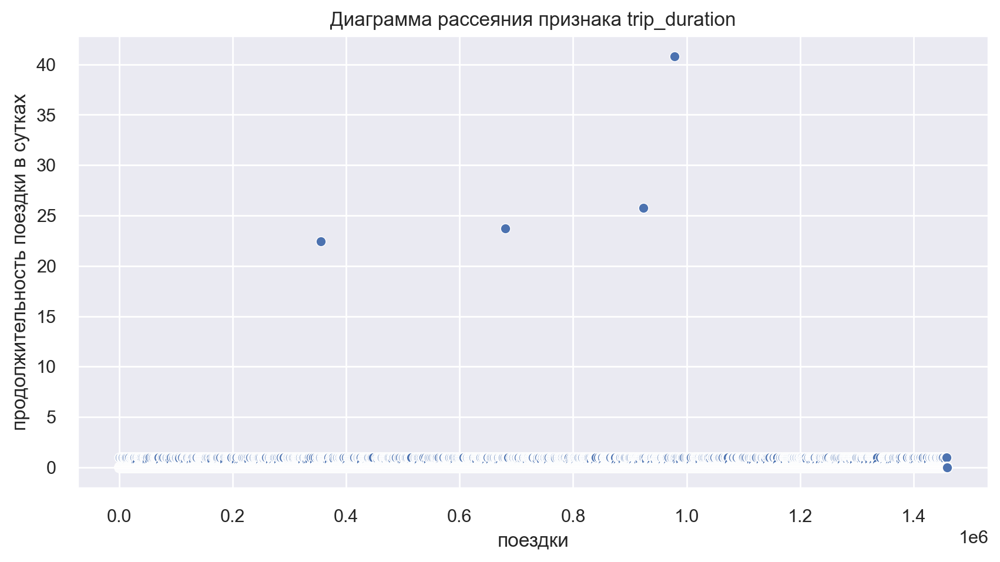

In [34]:
# построим диаграмму рассеяния признака trip_duration переведя секунды в сутки
sns.set(rc={'figure.figsize':(10,5)})
sns.scatterplot(x=taxi_data['trip_duration'].index, y=(taxi_data['trip_duration'] / 86400)).\
    set(
    title='Диаграмма рассеяния признака trip_duration', 
    xlabel='поездки', 
    ylabel='продолжительность поездки в сутках'
    );

На диаграмме выше мы видим 4 явные аномалии.

Создадим признак средней скорости поездки **average_speed**, как результат деления признака **total_distance** на **trip_duration** и переведем его в км/ч. Затем исследуем его на наличие аномалий.

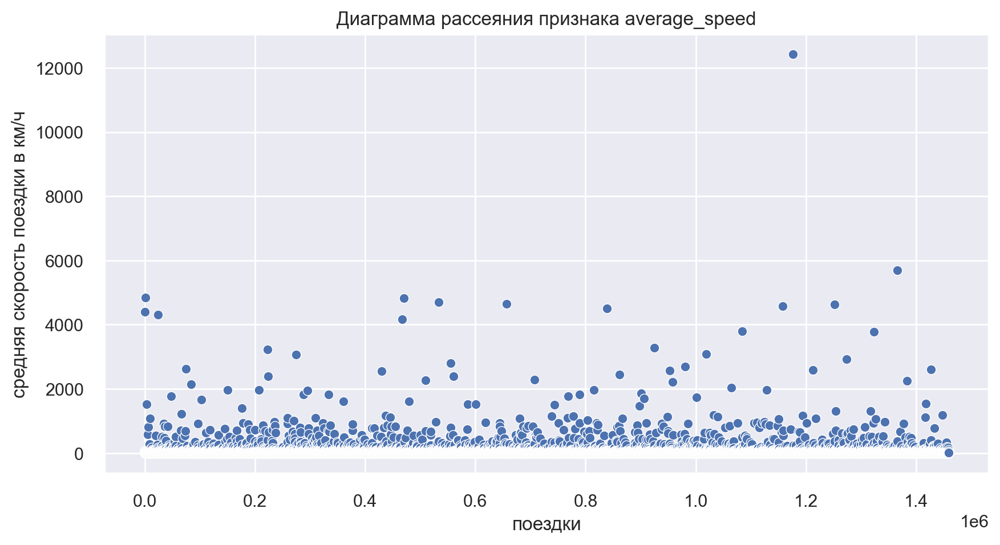

In [35]:
# создаем признак средней скорости
taxi_data['average_speed'] = taxi_data['total_distance'] / taxi_data['trip_duration'] * 3.6
# построим диаграмму рассеяния признака average_speed
sns.set(rc={'figure.figsize':(10,5)})
sns.scatterplot(x=taxi_data['average_speed'].index, y=taxi_data['average_speed']).\
    set(
    title='Диаграмма рассеяния признака average_speed', 
    xlabel='поездки', 
    ylabel='средняя скорость поездки в км/ч'
    );

Как раз отсюда мы видим, что у нас есть “поездки-телепортации”, для которых средняя скорость более 1000 км/ч. Даже есть такая, средняя скорость которой составляла более 12000 км/ч! 

Однако, какую скорость считать аномальной?   
Итак, данные у нас за 2016 год. Я наткнулся на [статью](http://transspot.ru/2013/08/05/skorost-avtomobilya-v-gorode-primery-razvityx-stran-chast-3/?ysclid=lfcs9cyota621598884) 2013 года, где описаны ограничения скорости в Нью-Йорке и пригороде, включая магистрали.    
Думаю, что скорость движения такси выше 100км/ч следует считать аномальной.


Узнаем количество найденных аномалий.

In [36]:
# маска для поездок длительность которых > 24 часа
mask_1 = taxi_data['trip_duration'] > 86400
# маска для поездок, средняя скорость которых > 100 км/ч
mask_2 = taxi_data['average_speed'] > 100

# выводим размерность данных с выбросами по обеим маскам
print(f'Количество поездок длительностью > 24 часов: {taxi_data[mask_1].shape[0]}')
print(f'Количество поездок со скоростью > 100км/ч: {taxi_data[mask_2].shape[0]}')
print(f'Количество поездок, имеющие аномалии: {taxi_data[mask_1 | mask_2].shape[0]}')

Количество поездок длительностью > 24 часов: 4
Количество поездок со скоростью > 100км/ч: 1202
Количество поездок, имеющие аномалии: 1206


Удаляем строки с аномальными значениями.

In [37]:
print(f'Размерность данных до удаления аномалий: {taxi_data.shape}')
taxi_data = taxi_data[(taxi_data['trip_duration'] <= 86400) & (taxi_data['average_speed'] <= 100)]
print(f'Размерность данных после удаления аномалий: {taxi_data.shape}')

Размерность данных до удаления аномалий: (1458643, 44)
Размерность данных после удаления аномалий: (1457437, 44)


Итак, с длительностью поездок более суток и средней скоростью более 100км/ч мы разобрались.    
Однако как насчет очень коротких поездок и маленьких средних скоростей?     
Из открытых [источников](https://vc.ru/transport/9469-uber-nyc?ysclid=lffx00t08n54867538) мы знаем, что к 2015 году средняя скорость движения по Манхэттену составляла менее 15км/ч. Поэтому, на мой взгляд, из-за наличия пробок в часы пик скорость движения автомобиля в Нью-Йорке может быть очень маленькой. Отсюда вывод - изучим подробнее среднюю скорость = 0 и попробуем там поискать аномалии. Среднюю скорость более 0 будем считать нормальной, даже если она будет = 1км/ч.    
Время поездки = 0 мы также изучим более подробно и попробуем там найти аномалии.     
Итак, приступим.

Посмотрим сколько поездок с длительностью 0 секунд.

In [38]:
mask_1 = taxi_data['trip_duration'] == 0
taxi_data[mask_1]['trip_duration'].value_counts()

Series([], Name: trip_duration, dtype: int64)

Поездок длительностью 0 секунд нет. Вроде, все в порядке.

Посмотрим сколько поездок со средней скоростью 0км/ч и сколько поездок с пройденным расстоянием равным 0.

In [39]:
# зададим маску средней скорости = 0
mask_2 = taxi_data['average_speed'] == 0
taxi_data[mask_2]['average_speed'].value_counts()

0.0    6009
Name: average_speed, dtype: int64

In [40]:
# какое расстояние поездки было тогда, когда средняя скорость = 0
taxi_data[mask_2]['total_distance'].value_counts()

0.0    6009
Name: total_distance, dtype: int64

У нас 6009 поездок со средней скоростью = 0 и признаком **total_distance** = 0, т.е. автомобиль не перемещался.

In [41]:
# зададим маску расстояния = 0
mask_3 = taxi_data['total_distance'] == 0
# определим продолжительность поездки в случаях когда такси не перемещалось
taxi_data[mask_3]['trip_duration'].value_counts()

4       116
3       107
5        96
8        70
9        70
       ... 
1379      1
1588      1
2047      1
1668      1
1284      1
Name: trip_duration, Length: 1563, dtype: int64

А вот тут что-то странное. Такси стояло на месте, а время поездки при этом не равно нулю (это мы уже выяснили выше), но даже далеко не всегда равно 1. Изучим этот вопрос более подробно в разрезе обоих таксопарков.

Размерность данных: (1914, 44)


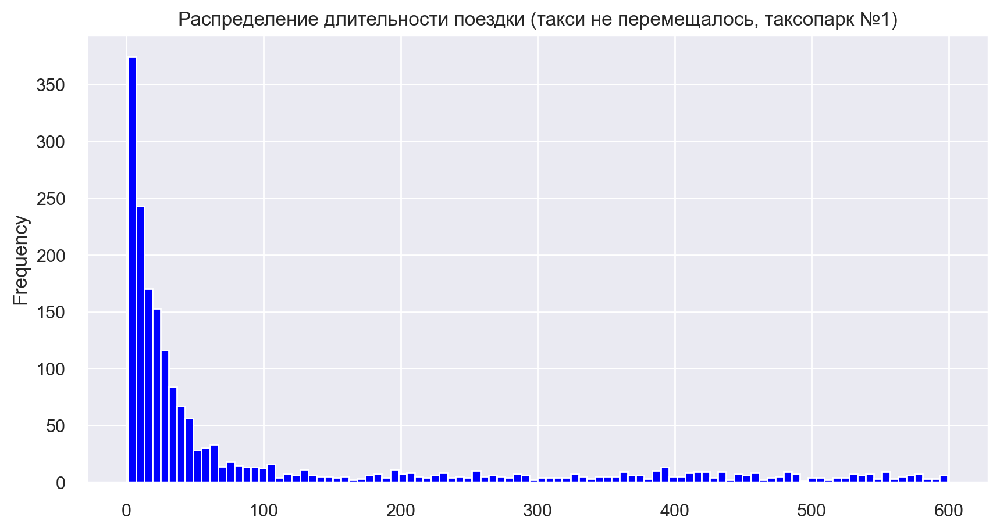

In [42]:
# маска длительности поездки не более 10 минут, расстояние = 0, такстопарк 1
mask = (taxi_data['trip_duration'] <= 600) & (taxi_data['total_distance'] == 0) & (taxi_data['vendor_id'] == 1)
taxi_data[mask]['trip_duration'].plot(
    kind='hist',
    figsize=(10, 5),
    title='Распределение длительности поездки (такси не перемещалось, таксопарк №1)',
    grid = True,
    color = 'blue',
    bins=100
);
print(f'Размерность данных: {taxi_data[mask].shape}')

Размерность данных: (3672, 44)


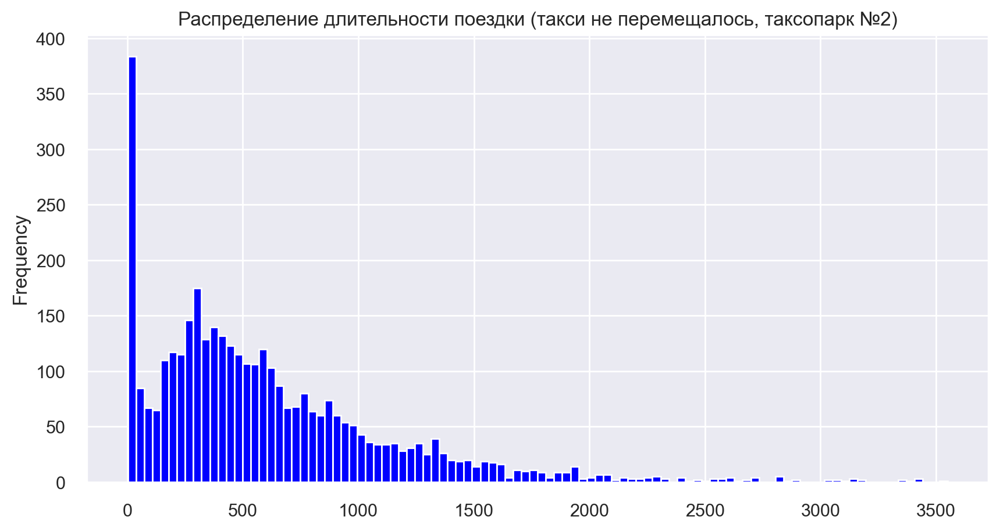

In [43]:
# маска длительности поездки не более 1 часа, расстояние = 0, такстопарк 2
mask = (taxi_data['trip_duration'] <= 3600) & (taxi_data['total_distance'] == 0) & (taxi_data['vendor_id'] == 2)
taxi_data[mask]['trip_duration'].plot(
    kind='hist',
    figsize=(10, 5),
    title='Распределение длительности поездки (такси не перемещалось, таксопарк №2)',
    grid = True,
    color = 'blue',
    bins=100
);
print(f'Размерность данных: {taxi_data[mask].shape}')

Что мы видим. В тасксопарке №1 длительность поездок, когда такси не перемещалось, длилось до 2 минут (все, что больше будем считать аномалиями). Возможно, таксист приезжал на заказ и включал счетчик, ждал до 2 минут и если поездка отменялась, то счетчик отключался. Возможно то, когда клиент подтверждал, что придет, а потом не приходил, приводило к тому, что счетчик выключался значительно позже (аномалии справа от 120сек).    
А вот с таксопарком №2 длительность поездок неперемещавшихся такси достигала 30 мин. Возможно, причины таких цифр те же, что и в таксопарке №1, просто в таксопарке №2 клиентов ждали до 30 минут, запустив при этом счетчик поездки.    
Теперь нужно решить, что делать с поездками, длительность которых более 0, но такси не перемещалось. Полагаю, что эти поездки надо удалять, т.к. они будут мешать моделям правильно рассчитывать время поездки и, соответственно, тариф.

In [44]:
# установим маски для случаев, когда такси не перемещалось во время поездки
mask_1 = taxi_data['pickup_latitude'] == taxi_data ['dropoff_latitude']
mask_2 = taxi_data['pickup_longitude'] == taxi_data ['dropoff_longitude']
mask_3 = taxi_data['average_speed'] == 0
mask_4 = taxi_data['total_distance'] == 0
mask_5 = taxi_data['haversine_distance'] == 0
# посмотрим размерность отфильтрованных по маскам данных
taxi_data[(mask_1 & mask_2) | mask_3 | mask_4 | mask_5].shape

(6009, 44)

Те же 6009 поездок. Удаляем.

In [45]:
print(f'Размерность данных до удаления: {taxi_data.shape}')
taxi_data.drop(index=taxi_data[(mask_1 & mask_2) | mask_3 | mask_4 | mask_5].index, inplace=True)
print(f'Размерность после удаления: {taxi_data.shape}')

Размерность данных до удаления: (1457437, 44)
Размерность после удаления: (1451428, 44)


Выше мы видели поездки с количеством пассажиров равными 0. Давайте изучим их более подробно.

Размерность данных: (44, 44)


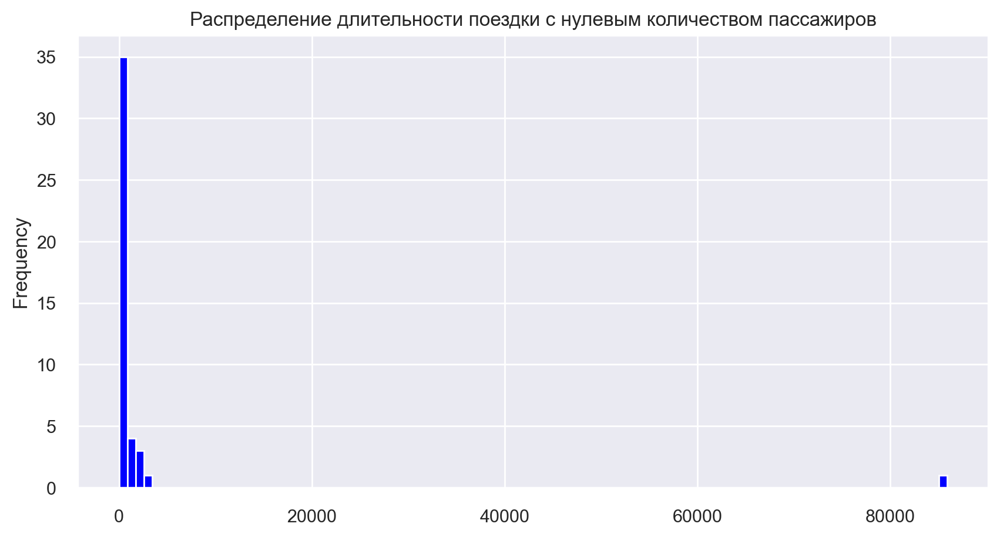

In [46]:
# маска количества пассажиров = 0
mask = taxi_data['passenger_count'] == 0
taxi_data[mask]['trip_duration'].plot(
    kind='hist',
    figsize=(10, 5),
    title='Распределение длительности поездки с нулевым количеством пассажиров',
    grid = True,
    color = 'blue',
    bins=100
);
print(f'Размерность данных: {taxi_data[mask].shape}')

В основном это очень короткие поездки длительностью 1 сек. Удаляем.

In [47]:
print(f'Размерность данных до удаления: {taxi_data.shape}')
taxi_data.drop(index=taxi_data[mask].index, inplace=True)
print(f'Размерность после удаления: {taxi_data.shape}')

Размерность данных до удаления: (1451428, 44)
Размерность после удаления: (1451384, 44)


- исследуем выбросы в географических данных

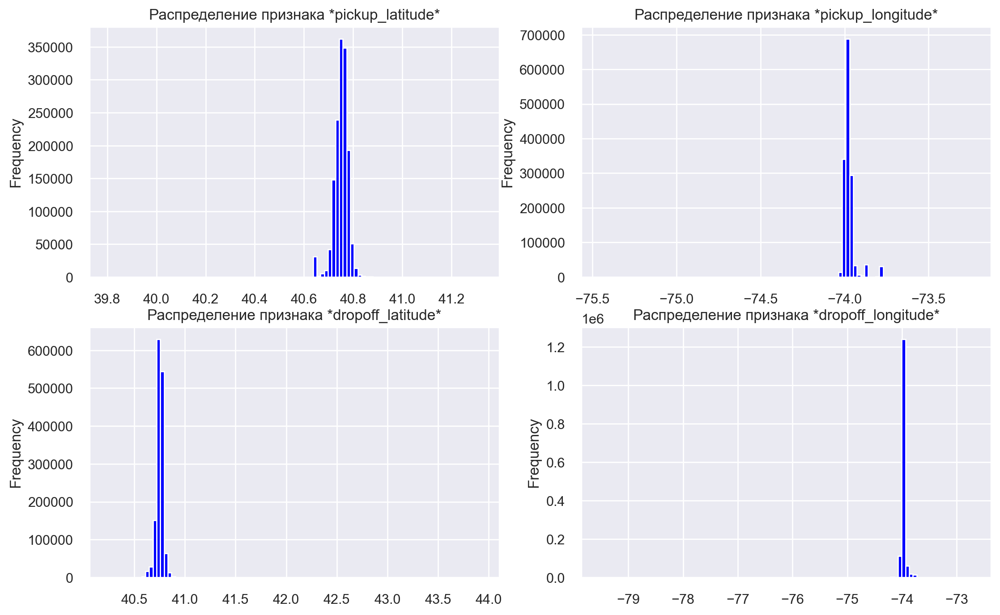

In [48]:
# признаки координат
features_list = ['pickup_latitude', 'pickup_longitude', 'dropoff_latitude', 'dropoff_longitude']

# визуализируем выбросы
fig = plt.figure()
for i, feature in enumerate(features_list):
    plt.subplot(2, 2, i+1)
    taxi_data[feature].plot(
        kind='hist',
        figsize=(13, 8),
        title=f'Распределение признака *{feature}*',
        grid = True,
        color = 'blue',
        bins=100
    );
plt.show();

В основном такси перемещаются по самому городу Нью-Йорку.     
Найдем те поездки, среди которых место включения либо выключения счетчика расположено за пределами города.

In [49]:
mask_longitude_pickup = (taxi_data['pickup_longitude'] < -74.03) | (taxi_data['pickup_longitude'] > -73.75)
mask_latitude_pickup = (taxi_data['pickup_latitude'] < 40.63) | (taxi_data['pickup_latitude'] > 40.85)

mask_longitude_dropoff = (taxi_data['dropoff_longitude'] < -74.03) | (taxi_data['dropoff_longitude'] > -73.75)
mask_latitude_dropoff = (taxi_data['dropoff_latitude'] < 40.63) | (taxi_data['dropoff_latitude'] > 40.85)

taxi_data[mask_latitude_pickup | mask_longitude_pickup | mask_longitude_dropoff | mask_latitude_dropoff].shape

(18869, 44)

Таких поездок достаточно много, однако они нам будут вносить проблемы при обучении модели. Удаляем.

In [50]:
print(f'Размерность данных до удаления: {taxi_data.shape}')
taxi_data.drop(index=taxi_data[
    mask_latitude_pickup | mask_longitude_pickup | mask_longitude_dropoff | mask_latitude_dropoff
    ].index, inplace=True)
print(f'Размерность после удаления: {taxi_data.shape}')

Размерность данных до удаления: (1451384, 44)
Размерность после удаления: (1432515, 44)


Проверим еще раз распределения значений в признаках координат.

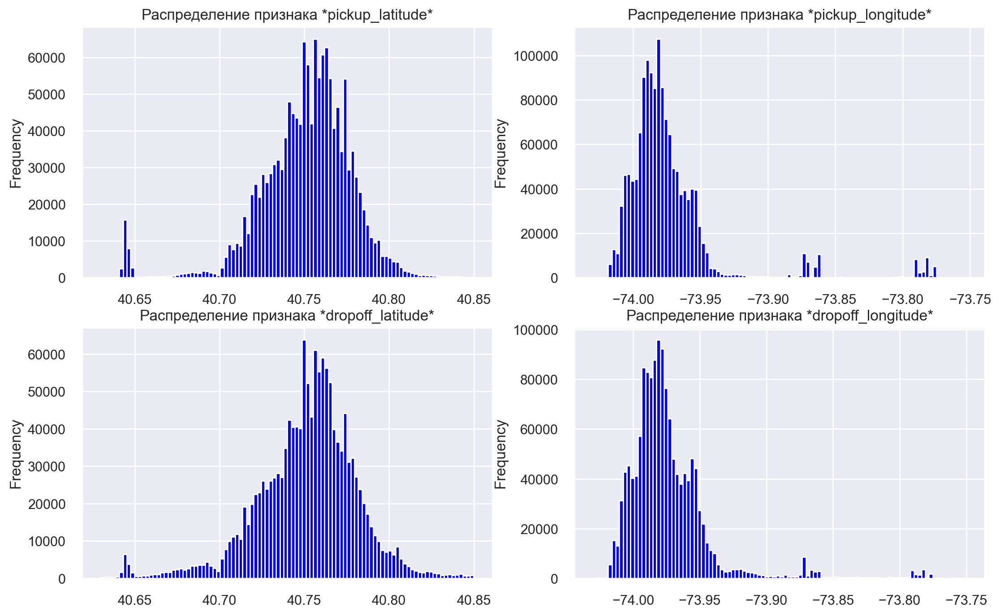

In [51]:
# визуализируем выбросы
fig = plt.figure()
for i, feature in enumerate(features_list):
    plt.subplot(2, 2, i+1)
    taxi_data[feature].plot(
        kind='hist',
        figsize=(13, 8),
        title=f'Распределение признака *{feature}*',
        grid = True,
        color = 'blue',
        bins=100
    );
plt.show();

***
***

## 3. Разведывательный анализ данных (EDA) и создание новых признаков

Для начала визуализируем степень абсолютной корреляции признаков с таргетом.

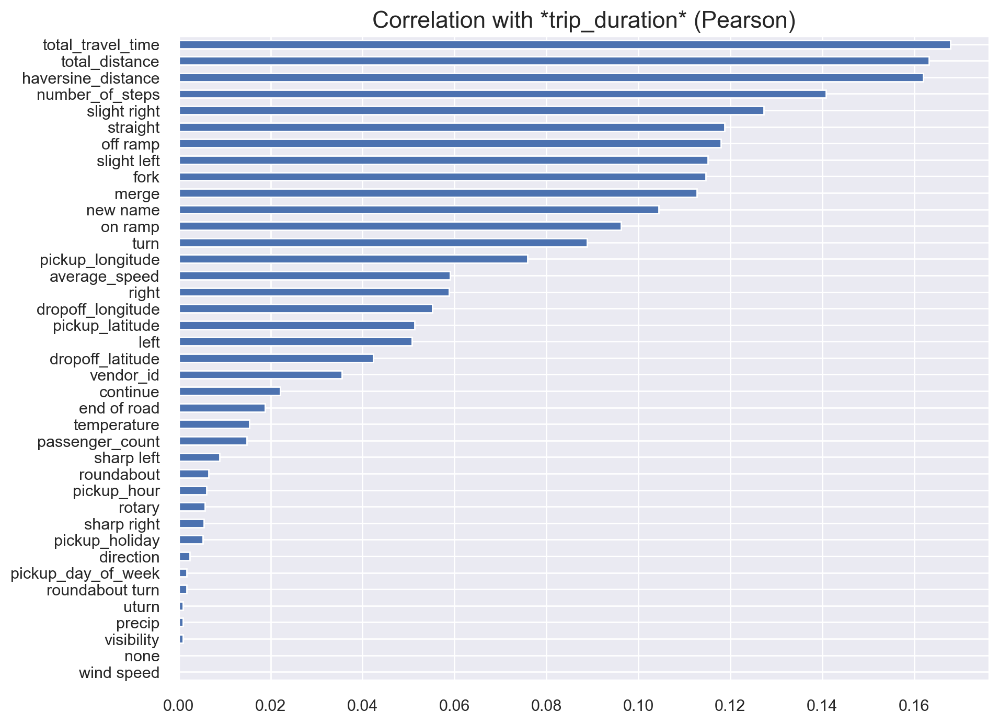

In [52]:
# визуализируем корреляцию Пирсона
taxi_data.corr()["trip_duration"].apply(lambda x: abs(x)).sort_values()[:-1].plot.barh(figsize=(10, 8))
plt.title("Correlation with *trip_duration* (Pearson)", fontsize = 16)
plt.show();

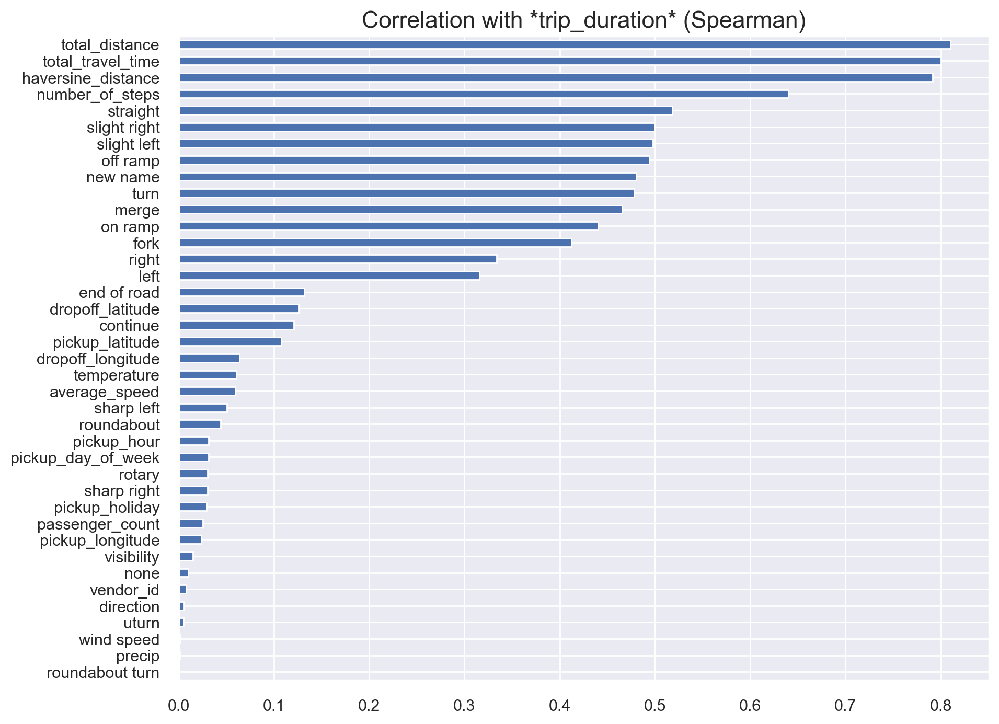

In [53]:
# визуализируем корреляцию Спирмена
taxi_data.corr(method='spearman')["trip_duration"].apply(lambda x: abs(x)).sort_values()[:-1].plot.barh(figsize=(10, 8))
plt.title("Correlation with *trip_duration* (Spearman)", fontsize = 16)
plt.show();

**Выводы:**
- при визуализации обеих корреляций (Пирсона и Спирмена) 4-ка лидеров одинакова: **total_distance**, **total_travel_time**, **haversine_distance**, **number_of_steps**
- однако, сразу заметно, что при вычислении корреляции Пирсона абсолютное значение корреляции не превышает 0.175, в то время, как при вычислении кореляции Спирмена цифры превышают 0.8
- ниже мы обнаружим, что данные таргета **trip_duration** не распределены нормально
- учитывая вышеизложенное, полагаю, что правильным будет оценивать **корреляцию Спирмена**, а не Пирсона
- в топе лидеров признаки, которые мы получили из дополнительных источников

### 3.1. Целевая переменая **trip_duration**

Длительность поездки.

Основной метрикой качества решения поставленной задачи будет RMSLE - Root Mean Squared Log Error, которая вычисляется на основе целевой переменной в логарифмическом масштабе. В таком случае целесообразно сразу логарифмировать признак длительности поездки и рассматривать при анализе логарифм в качестве целевого признака:
$$trip\_duration\_log = log(trip\_duration+1),$$
где под символом log подразумевается натуральный логарифм.


In [54]:
# создадим логарифмированный вариант признака trip_duration
taxi_data['trip_duration_log'] = np.log(taxi_data['trip_duration']+1)

Визуализируем распределение целевой переменной (обычный и логарифмированный вариант).

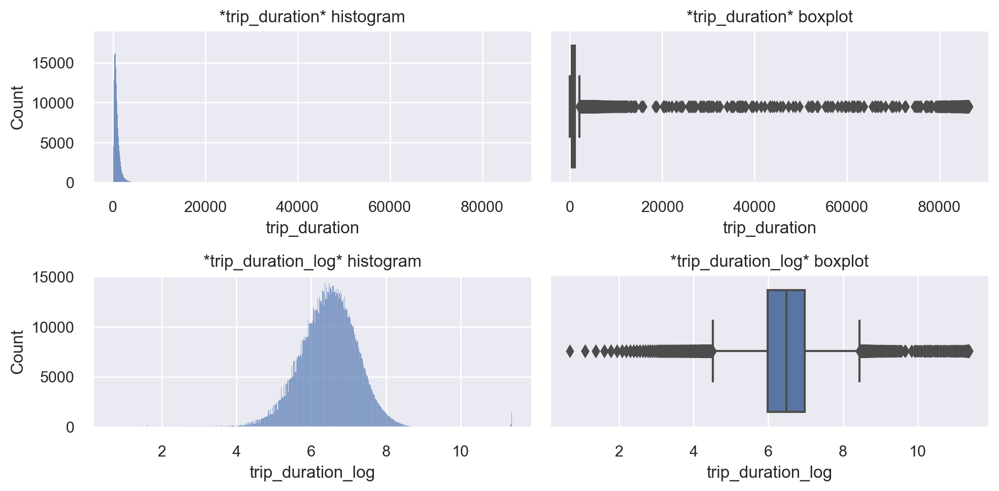

In [55]:
sns.set(rc={'figure.figsize':(10,5)})
num_features_visual(taxi_data, 'trip_duration', 'trip_duration_log')

Явно имеются выбросы.

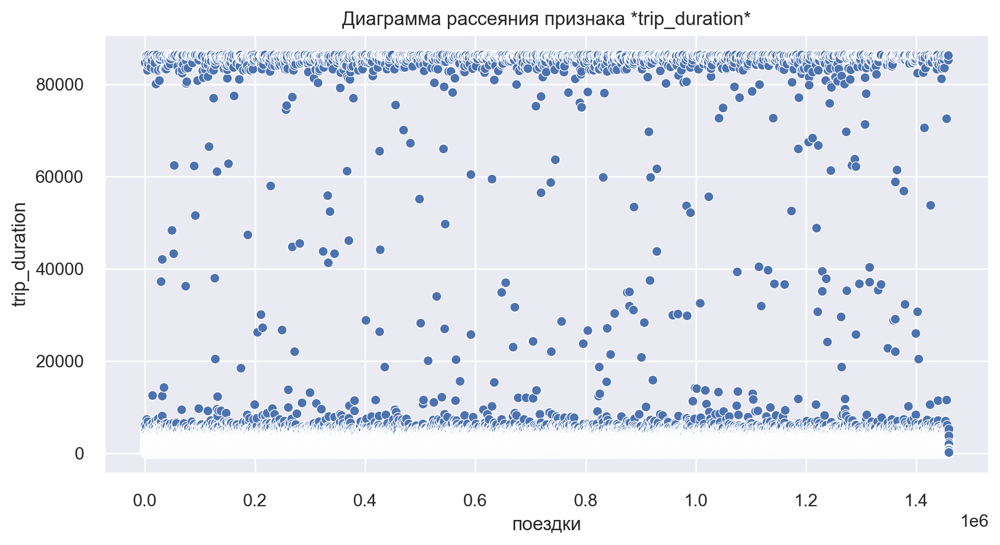

In [56]:
# построим диаграмму рассеяния признака trip_duration 
num_features_visual_scatter(taxi_data, 'trip_duration')

На диаграмме рассеяния выше мы видим, что в основном поездки "кучкуются" внизу диаграммы, а также вверху, где их продолжительность более 80тыс. секунд (почти сутки). Между этими двумя группами имеется разреженное пространство с небольшим количеством поездок. Данное неравномерное распределение будет создавать нам проблемы при предсказании таргета. Навскидку, основная масса поездок группируется в области продолжительности поездки менее 5000 секунд.

Построим еще одну диаграмму распределения целевой переменной и посмотрим, сколько поездок продолжительностью выше и ниже 5000 секунд.

Размерность данных при поездках <= 5000 сек: (1428953, 45)
Размерность данных при поездках > 5000 сек: (3562, 45)


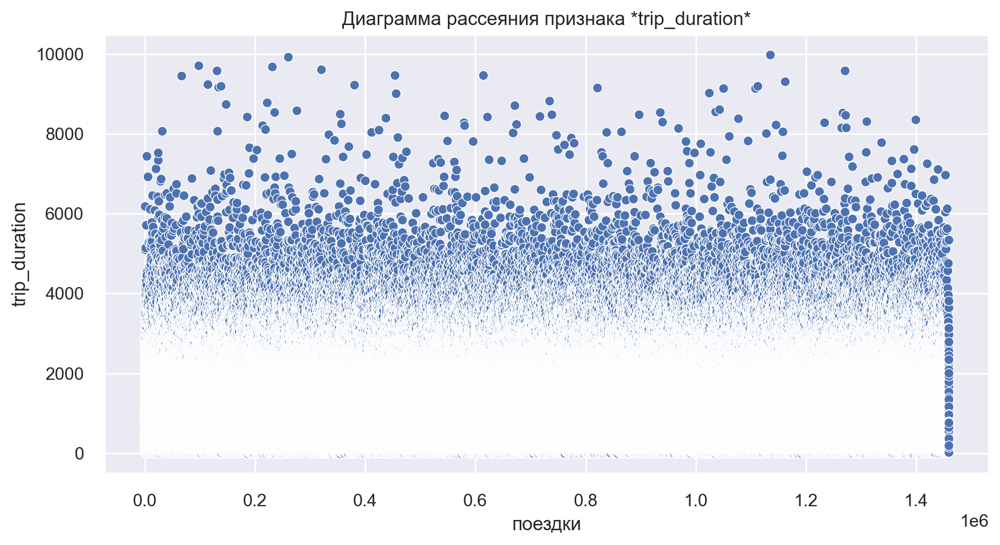

In [57]:
# обозначим маски
mask = taxi_data['trip_duration'] <= 10000
mask_1 = taxi_data['trip_duration'] <= 5000
mask_2 = taxi_data['trip_duration'] > 5000

# построим диаграмму рассеяния признака trip_duration в пределах 10000 сек
num_features_visual_scatter(taxi_data[mask], 'trip_duration')

# выведем размерность данных выше/ниже 5000 сек
print(f'Размерность данных при поездках <= 5000 сек: {taxi_data[mask_1].shape}')
print(f'Размерность данных при поездках > 5000 сек: {taxi_data[mask_2].shape}')

Полагаю, что если мы удалим поездки продолжительностью более 5000 сек, мы сильно упростим работу модели. Датасет при этом уменьшится незначительно.

In [58]:
# удалим найденые выбросы
taxi_data = taxi_data[mask_1]
taxi_data.shape

(1428953, 45)

Повторно проверим распределение таргета.

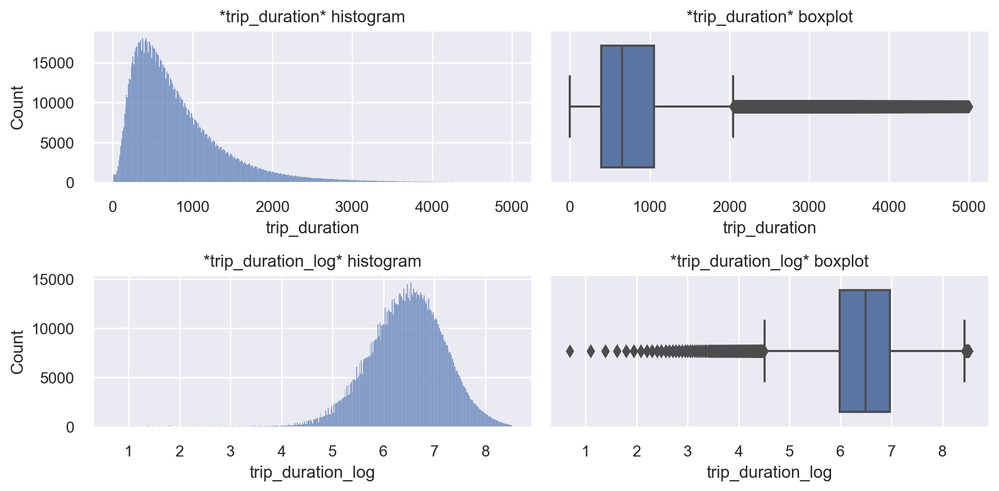

In [59]:
num_features_visual(taxi_data, 'trip_duration', 'trip_duration_log')

Выглядит уже получше.    

Теперь проверим нормально ли распределены данные в признаках **trip_duration** и **trip_duration_log**.

- Тест Д'Агостино

In [60]:
H0 = 'Данные распределены нормально'
Ha = 'Данные не распределены нормально (мы отвергаем H0)'

alpha = 0.05

# признаки для теста
features = ['trip_duration', 'trip_duration_log']

for feature in features:

    print(f"Результаты теста Д'Агостино для признака {feature}")

    # проводим тест и выводим результат
    k2,p = normaltest(taxi_data[feature])
    print('p=%.3f' % p)

    # Интерпретация результатов теста
    if p > alpha:
	    print(H0)
    else:
	    print(Ha)

Результаты теста Д'Агостино для признака trip_duration
p=0.000
Данные не распределены нормально (мы отвергаем H0)
Результаты теста Д'Агостино для признака trip_duration_log
p=0.000
Данные не распределены нормально (мы отвергаем H0)


- Тест Шапиро-Уилка

In [61]:
for feature in features:

    print(f"Результаты Шапиро-Уилка для признака {feature}")

    # выполняем тест и выводим результат
    _, p = shapiro(taxi_data[feature])
    print('p=%.3f' % p)

    # Интерпретация результатов теста
    if p > alpha:
	    print(H0)
    else:
	    print(Ha)

Результаты Шапиро-Уилка для признака trip_duration
p=0.000
Данные не распределены нормально (мы отвергаем H0)
Результаты Шапиро-Уилка для признака trip_duration_log
p=0.000
Данные не распределены нормально (мы отвергаем H0)


**Выводы:**
- мы тщательно проанализировали распределение признака **trip_duration** и его логарифмического варианта и пришли к выводу, что лучше удалить данные с длительностью поездки более 5000 секунд, т.к. это, с одной стороны, упростит работу модели, а с другой - не приведет к большим потерям в исходных данных.
- данные в признаках длительности поездки не распределены нормально.

***

### 3.2. Признак **vendor_id**

Уникальный идентификатор поставщика (таксопарка), связанного с записью поездки.

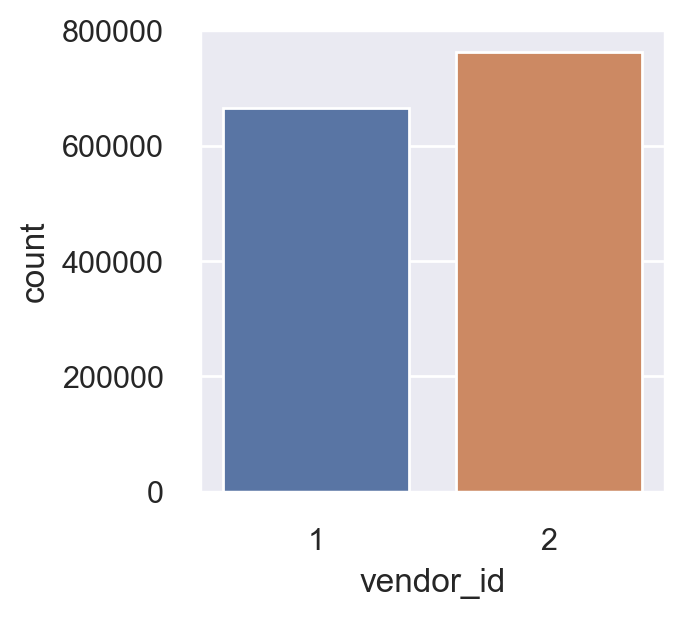

In [62]:
# визуализируем значения признака
sns.set(rc={'figure.figsize':(3,3)})
sns.countplot(taxi_data['vendor_id']);

Визуализируем зависимость целевой переменной **trip_duration** от данного признака.

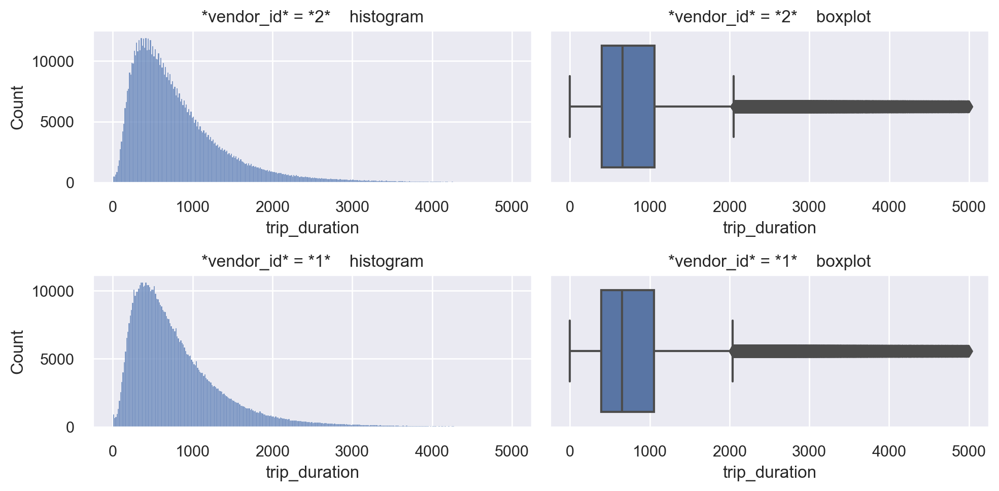

In [63]:
sns.set(rc={'figure.figsize':(10,5)})
cat_feature_target_visual(taxi_data, 'vendor_id', 'trip_duration')

Визуализируем зависимость целевой переменной **trip_duration_log** от данного признака.

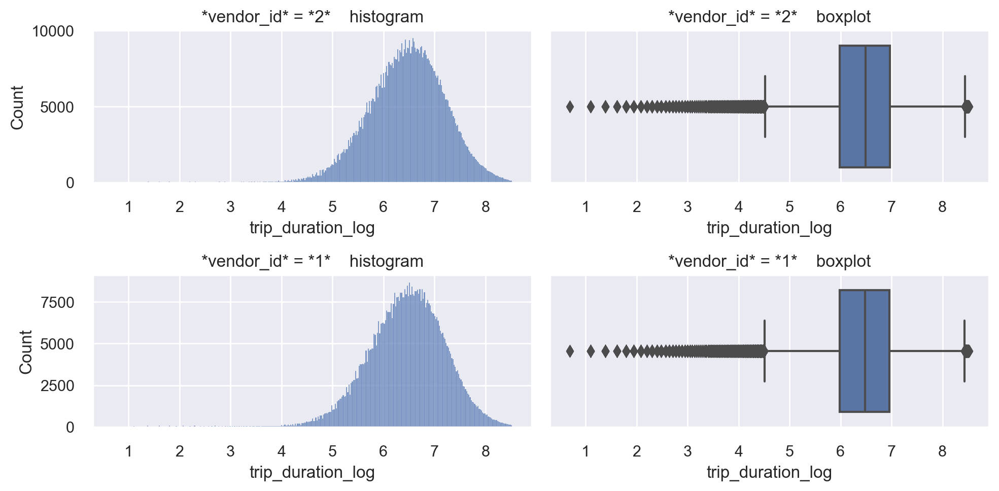

In [64]:
cat_feature_target_visual(taxi_data, 'vendor_id', 'trip_duration_log')

Расчитаем медианную и среднюю длительность поездки в зависимости от **vendor_id**.

In [65]:
feature_median_and_mean_target(taxi_data, 'vendor_id')

,vendor_id,count,trip_duration_median,trip_duration_mean
0,1,665985,653.0,815.991733
1,2,762968,658.0,825.280438


**Выводы:**
- идентификатор таксопарка = 2 встречается в данных о поездках чаще.
- какой-то существенной разницы в длительности поездок между 2-мя таксопарками мы не видим.
- полагаю, что признак будет не сильно важен для задачи регрессии (что подтверждается данными корреляции выше).

In [66]:
# преобразуем признак в бинарный на обеих выборках
taxi_data['vendor_id'] = taxi_data['vendor_id'].apply(
    lambda x: 1 if x == 1 else 0
)
test_data['vendor_id'] = test_data['vendor_id'].apply(
    lambda x: 1 if x == 1 else 0
)

**Дополнительно.** Кстати, а давайте подумаем, что это за таксопарки. Мы имеем задачу для DS(!), при этом в данных были поездки длительностью более 0 в случаях, когда такси не перемещалось. Объяснить это можно только тем, что такси приезжало по заказу. Мы знаем из открытых источников, что обычные желтые/зеленые такси в 2016 году (сейчас не знаю) не приезжали по заказу (не путать с кар сервисом), они брали голосующих клиентов на улице или ожидали случайных клиентов возле гостиниц, отелей, в аэропортах. Учитывая вышеизложенное, мы имеем дело с агрегаторами такси. В 2016 году в Нью-Йорке точно были Uber и Lyft (агрегаторы только начали появляться после решения мэра в 2015). Представленные данные - это данные агрегаторов, вероятнее всего Uber и Lyft.  

***

### 3.3. Признак **store_and_fwd_flag**

Флаг, который указывает, сохранилась ли запись о поездке в памяти транспортного средства перед отправкой поставщику.     
Y - хранить и пересылать, N - не хранить и не пересылать поездку.

N    1421198
Y       7755
Name: store_and_fwd_flag, dtype: int64

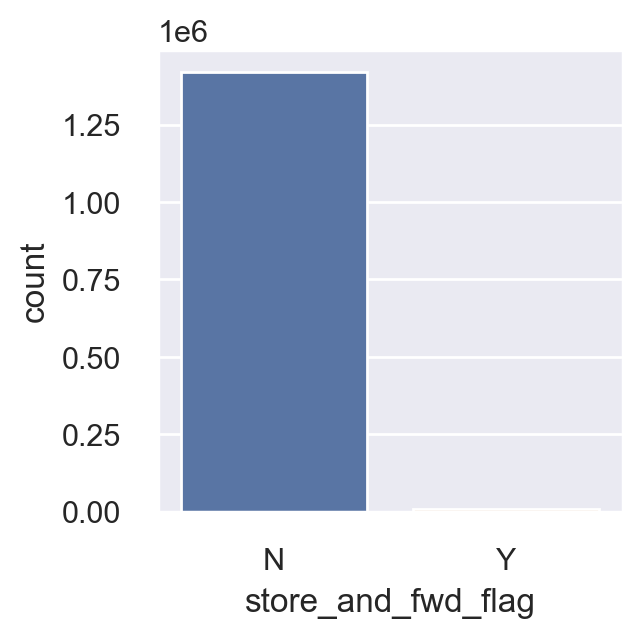

In [67]:
# визуализируем значения признака
sns.set(rc={'figure.figsize':(3,3)})
sns.countplot(taxi_data['store_and_fwd_flag']);
# рассчитываем количество значений признака
taxi_data['store_and_fwd_flag'].value_counts()

Визуализируем зависимость целевой переменной **trip_duration** от данного признака.

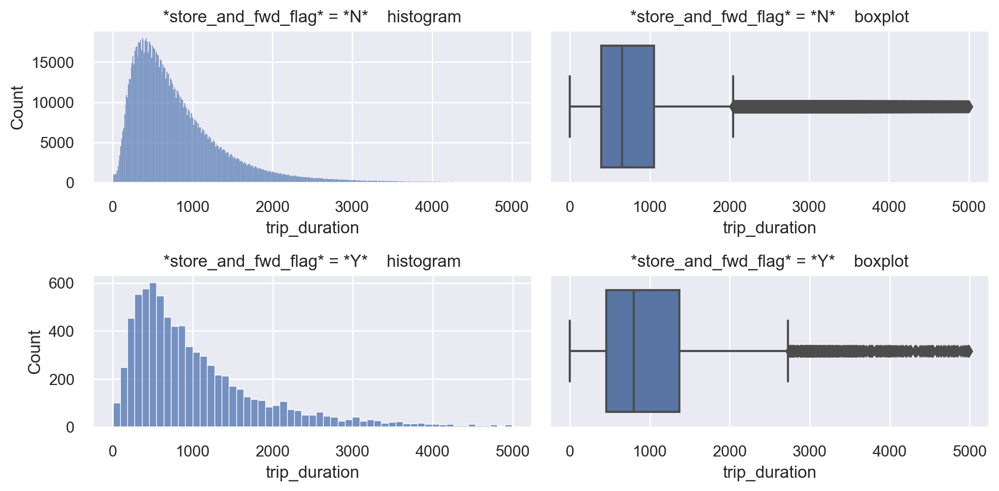

In [68]:
sns.set(rc={'figure.figsize':(10,5)})
cat_feature_target_visual(taxi_data, 'store_and_fwd_flag', 'trip_duration')

Визуализируем зависимость целевой переменной **trip_duration_log** от данного признака.

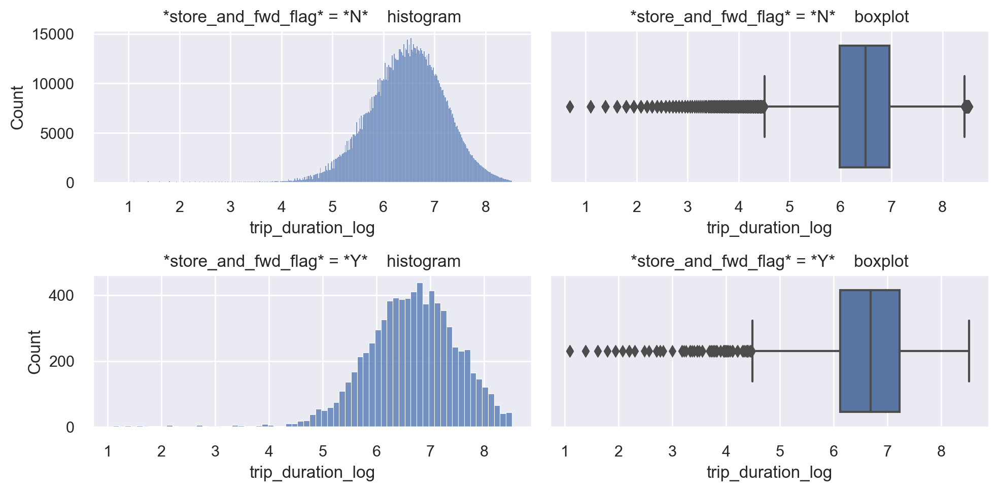

In [69]:
cat_feature_target_visual(taxi_data, 'store_and_fwd_flag', 'trip_duration_log')

Расчитаем медианную и среднюю длительность поездки в зависимости от **store_and_fwd_flag**.

In [70]:
feature_median_and_mean_target(taxi_data, 'store_and_fwd_flag')

,store_and_fwd_flag,count,trip_duration_median,trip_duration_mean
0,N,1421198,655.0,819.720024
1,Y,7755,801.0,1046.597034


**Выводы:**
- по количеству значений признак очень сильно несбалансирован, в подавляющем большинстве имеет значение = N.
- разница в длительности поездок есть и, при этом, существенная.
- при значении признака = Y длительность поездки увеличивается.
- полагаю, что признак важен, но вряд ли он нам сильно поможет, т.к. по количеству значений сильно несбалансирован.
- выполним бинарное кодирование признака: N=0, Y=1.

In [71]:
# преобразуем признак в бинарный на обеих выборках
taxi_data['store_and_fwd_flag'] = taxi_data['store_and_fwd_flag'].apply(
    lambda x: 1 if x == 'Y' else 0
)
test_data['store_and_fwd_flag'] = test_data['store_and_fwd_flag'].apply(
    lambda x: 1 if x == 'Y' else 0
)

***

### 3.4. Месяц поездки **pickup_month** (выделим из даты включения счетчика).

Создадим новый признак - месяц включения счетчика (месяц поездки) и оценим влияние признака на длительность поездки.

In [72]:
# создаем новый признак - месяц включения счетчика
taxi_data['pickup_month'] = taxi_data['pickup_date'].dt.month

Визуализируем связь признака **pickup_month** с таргетом.

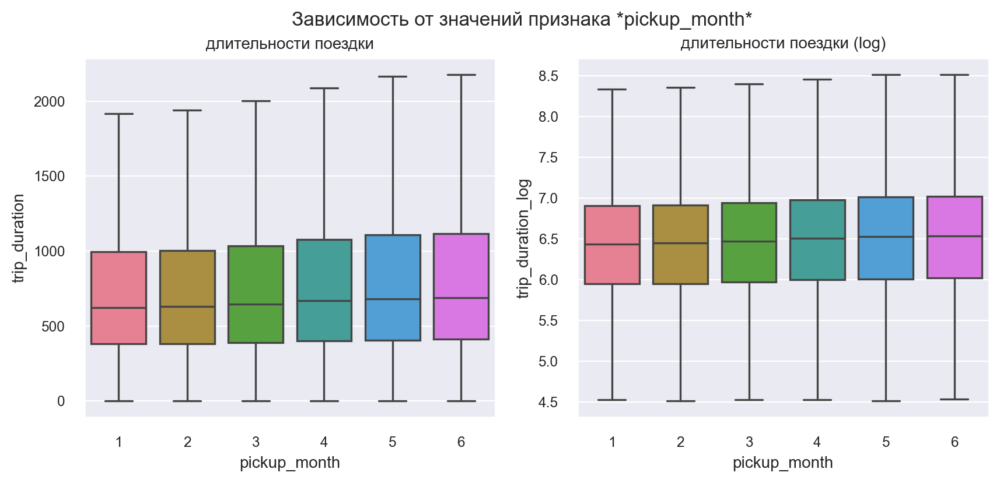

In [73]:
cat_feature_target_visual_version_2(taxi_data, 'pickup_month', h_size = 10, v_size=4)

Визуализируем количество поездок, медианную и среднюю длительность поездки в зависимости от **pickup_month**.

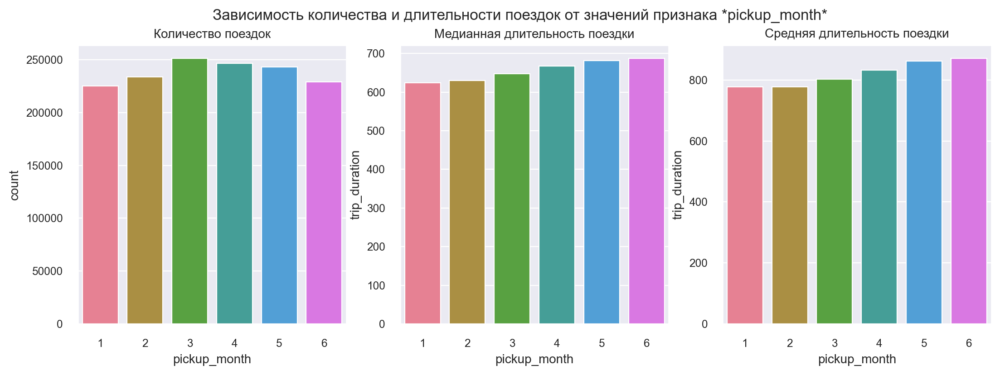

In [74]:
cat_feature_target_visual_version_3(taxi_data, 'pickup_month', h_size = 13, v_size=4)

Расчитаем в виде таблицы количество поездок, медианную и среднюю длительность поездки в зависимости от **pickup_month**.

In [75]:
feature_median_and_mean_target(taxi_data, 'pickup_month')

,pickup_month,count,trip_duration_median,trip_duration_mean
0,1,225168,624.0,777.590768
1,2,233861,630.0,777.590462
2,3,251132,647.0,803.298911
3,4,246526,668.0,832.395423
4,5,243046,682.0,862.734034
5,6,229220,687.0,870.512809


**Выводы:**
- признак является категориальным.
- отмечается рост поездок с января по март включительно, затем их количество снижается до июня включительно, однако не достигает уровня января.
- продолжительность поездки растет с января по июнь.
- с признаком ничего делать не будем - с ростом числа месяца, растет медиана поездки, т.е. признак уже порядково закодирован.

Выполним порядковое кодирование признака в тестовой выборке.

In [76]:
# создадим словарь для кодировки pickup_month тестовой выборки

# группируем по pickup_month и сортируем данные в сторону возрастания медианы длительности поездки
groupped = taxi_data.groupby(['pickup_month']).agg({'trip_duration':'median'}).sort_values(by='trip_duration').reset_index()

# словарь вида месяц_поездки:порядковый_номер (от 1 до 6) в сторону увеличения медианы длительности поездки
values_pickup_month = {}
# заполняем словарь
for index, row in groupped.iterrows():
    values_pickup_month[int(row['pickup_month'])] = index + 1

# выполняем кодировку признака на тестовой выборке

# выделим признак pickup_month
test_data['pickup_month'] = test_data['pickup_date'].dt.month 
# кодируем признак
test_data['pickup_month'] = test_data['pickup_month'].apply(
    lambda x: values_pickup_month[x]
)

***

### 3.5. Признаки **pickup_day_of_week** и **pickup_holiday**

- **pickup_day_of_week** - день недели поездки.
- **pickup_holiday** - являлся ли день поездки выходным (значение 1, если являлся)

Визуализируем связь признака **pickup_day_of_week** с таргетом.

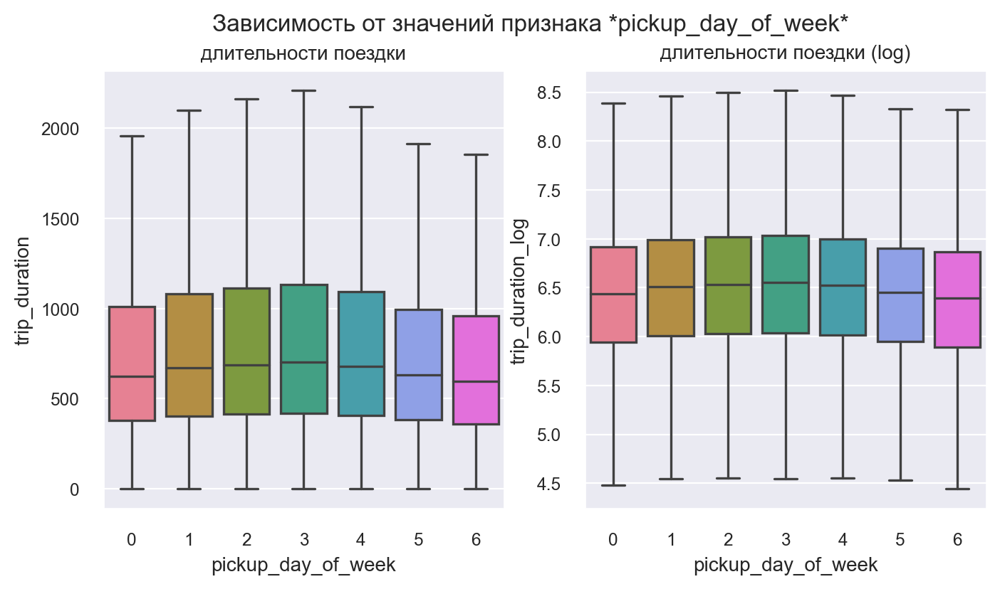

In [77]:
cat_feature_target_visual_version_2(taxi_data, 'pickup_day_of_week', h_size = 8, v_size=4)

Визуализируем количество поездок, медианную и среднюю длительность поездки в зависимости от **pickup_day_of_week**.

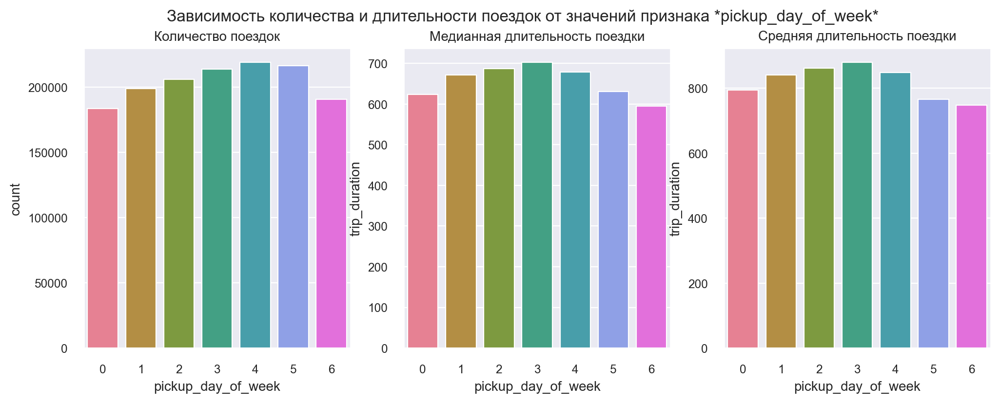

In [78]:
cat_feature_target_visual_version_3(taxi_data, 'pickup_day_of_week', h_size = 12, v_size=4)

Расчитаем в виде таблицы количество поездок, медианную и среднюю длительность поездки в зависимости от **pickup_day_of_week**.

In [79]:
feature_median_and_mean_target(taxi_data, 'pickup_day_of_week')

,pickup_day_of_week,count,trip_duration_median,trip_duration_mean
0,0,183740,624.0,794.540062
1,1,198808,672.0,840.066869
2,2,206067,687.0,862.326467
3,3,214005,702.0,879.014018
4,4,218922,679.0,848.118015
5,5,216499,631.0,766.555180
6,6,190912,595.0,747.252499


Таким же образом оценим признак **pickup_holiday**. Нам важно выяснить, какая длительность поездки была в праздничные дни и сравнить ее с длительностью в обычные дни ( особенно в субботу и воскресенье).

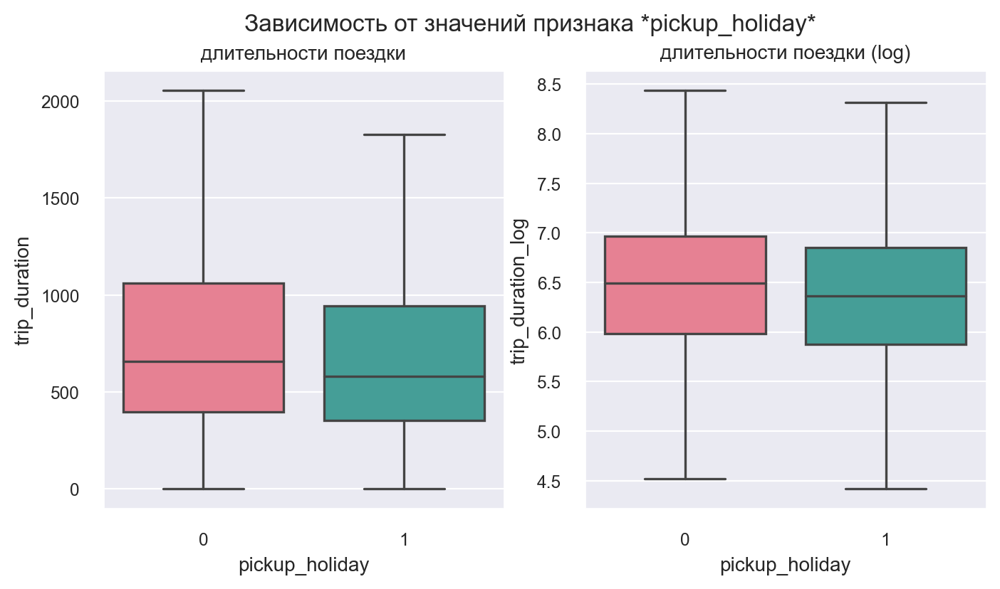

In [80]:
cat_feature_target_visual_version_2(taxi_data, 'pickup_holiday', h_size = 8, v_size=4)

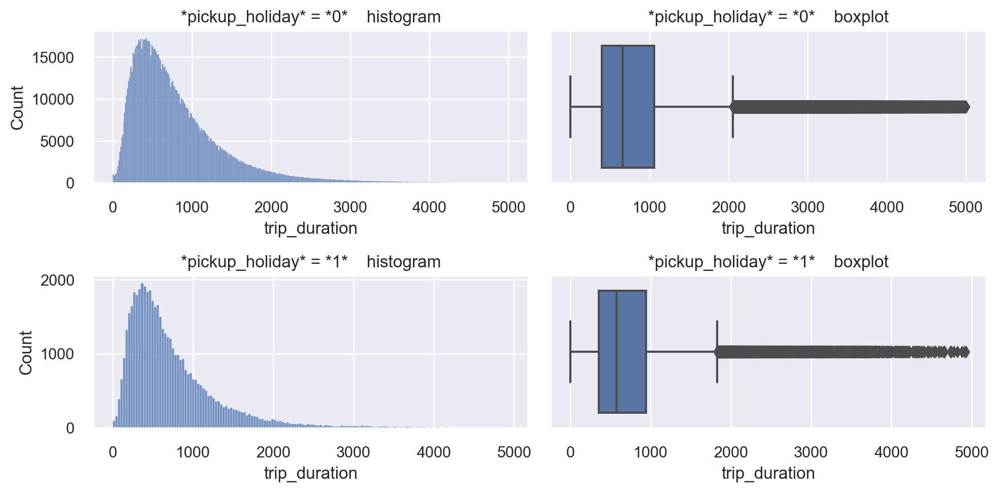

In [81]:
sns.set(rc={'figure.figsize':(10,5)})
cat_feature_target_visual(taxi_data, 'pickup_holiday', 'trip_duration')

In [82]:
feature_median_and_mean_target(taxi_data, 'pickup_holiday')

,pickup_holiday,count,trip_duration_median,trip_duration_mean
0,0,1378976,659.0,823.861545
1,1,49977,579.0,740.651120


In [83]:
# узнаем на какие дни недели приходились праздники
taxi_data.groupby(['pickup_holiday','pickup_day_of_week']).agg({'pickup_day_of_week':'count'})

pickup_day_of_week
pickup_holiday pickup_day_of_week                    
0              0                               164046
               1                               198808
               2                               206067
               3                               214005
               4                               203023
               5                               216499
               6                               176528
1              0                                19694
               4                                15899
               6                                14384

Интересно... Давайте теперь повторно визуализируем признак **pickup_day_of_week**, но уже отбросив поездки в праздничные дни.

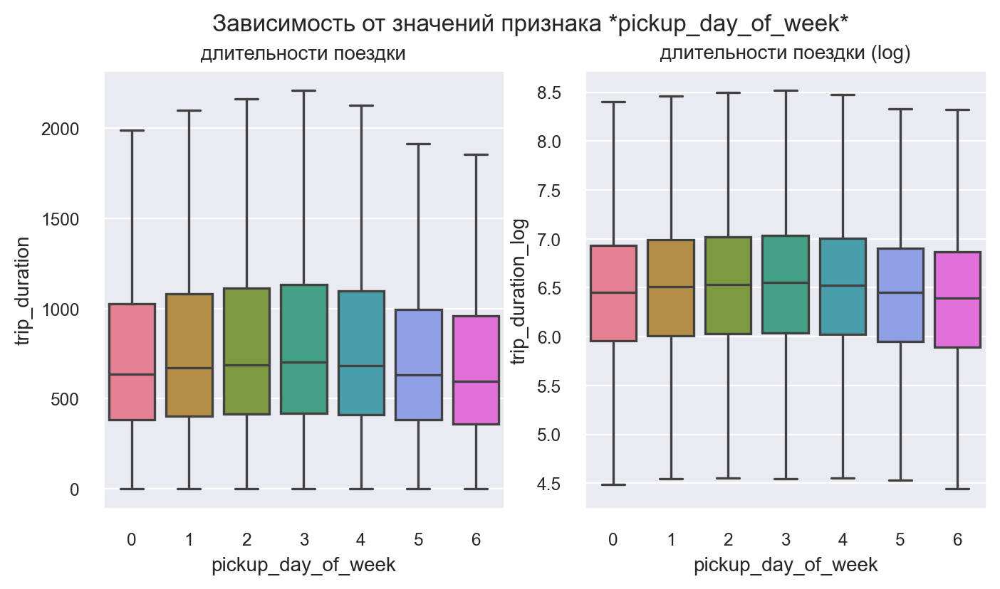

In [84]:
cat_feature_target_visual_version_2(taxi_data[taxi_data['pickup_holiday'] == 0], 'pickup_day_of_week', h_size = 8, v_size=4)

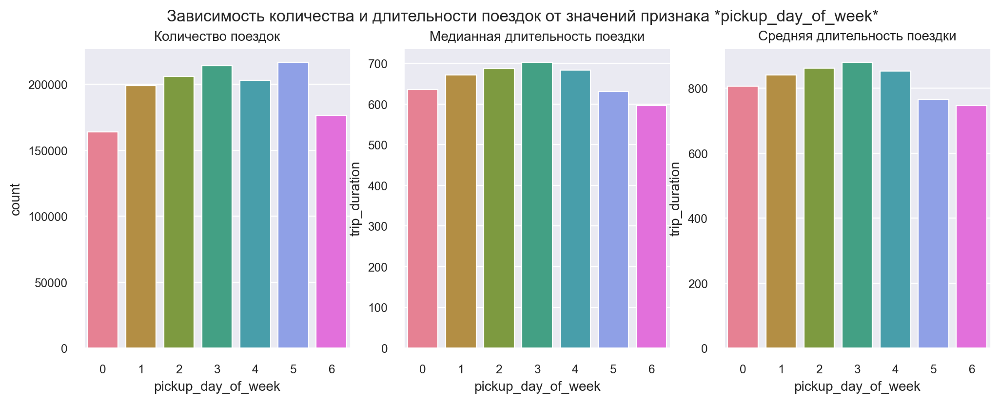

In [85]:
cat_feature_target_visual_version_3(taxi_data[taxi_data['pickup_holiday'] == 0], 'pickup_day_of_week', h_size = 12, v_size=4)

In [86]:
feature_median_and_mean_target(taxi_data[taxi_data['pickup_holiday'] == 0], 'pickup_day_of_week')

,pickup_day_of_week,count,trip_duration_median,trip_duration_mean
0,0,164046,635.0,806.947051
1,1,198808,672.0,840.066869
2,2,206067,687.0,862.326467
3,3,214005,702.0,879.014018
4,4,203023,683.0,853.036360
5,5,216499,631.0,766.555180
6,6,176528,596.0,746.295171


**Выводы:**
- признак **pickup_day_of_week** является категориальным.
- неожиданно, но минимальное количнество поездок мы видим в понедельник; наибольшее количество поездок наблюдается (по возрастанию) в четверг, субботу и пятницу, а если оценивать без праздничных дней - среда, четверг, суббота. Также мало поездок в воскресенье.
- есть явная прямая корреляция между количеством поездок в день недели (включая праздники) и их медианной и средней продолжительностью.
- если оценивать среднюю и медианную длительность поездки, то в понедельных и на выходных поездки короче, а со вторника по пятницу более длительные (пик длительности в четверг).
- можно дополнительно выделить сигнальные признаки: день поездки либо со вторника по пятницу, либо с субботы по понедельник.
- отмечается достаточно большое количество поездок в праздничные дни. 
- отмечается снижение длительности поездки в праздничный день, она ниже, чем даже если мы сравниваем с обычным выходным днем.
- важно отметить, что большинство праздничных поездок выпало на понедельник; также праздничные поездки были в пятницу и воскресенье (реже всего). 
- важно еще отметить, что в США праздник чаще "цепляется" к выходным - в пятницу или понедельник.
- выполним порядковое кодирование признака.

In [87]:
# создадим новый признак pickup_day_of_week_1234 - поездка со вторника по пятницу
taxi_data['pickup_day_of_week_1234'] = taxi_data['pickup_day_of_week'].apply(
    lambda x: 1 if x in range(1,5) else 0
)
# создадим новый признак pickup_day_of_week_1234 для тестовой выборки
test_data['pickup_day_of_week_1234'] = test_data['pickup_day_of_week'].apply(
    lambda x: 1 if x in range(1,5) else 0
)

In [88]:
# группируем по pickup_day_of_week и сортируем данные в сторону возрастания медианы длительности поездки
# используем маску, что день недели не является праздничным
mask = taxi_data['pickup_holiday'] == 0
groupped = taxi_data[mask].groupby(['pickup_day_of_week']).agg({'trip_duration':'median'}).sort_values(by='trip_duration').reset_index()

# словарь вида день_недели_поездки:порядковый_номер (от 1 до 7) в сторону увеличения медианы длительности поездки
values_pickup_day_of_week = {}
# заполняем словарь
for index, row in groupped.iterrows():
    values_pickup_day_of_week[int(row['pickup_day_of_week'])] = index + 1

# выполняем кодировку признака pickup_day_of_week на обеих выборках
taxi_data['pickup_day_of_week'] = taxi_data['pickup_day_of_week'].apply(
    lambda x: values_pickup_day_of_week[x]
)
test_data['pickup_day_of_week'] = test_data['pickup_day_of_week'].apply(
    lambda x: values_pickup_day_of_week[x]
)

***

### 3.6. Признак **pickup_hour**

Час начала поездки.

Визуализируем связь признака **pickup_hour** с таргетом.

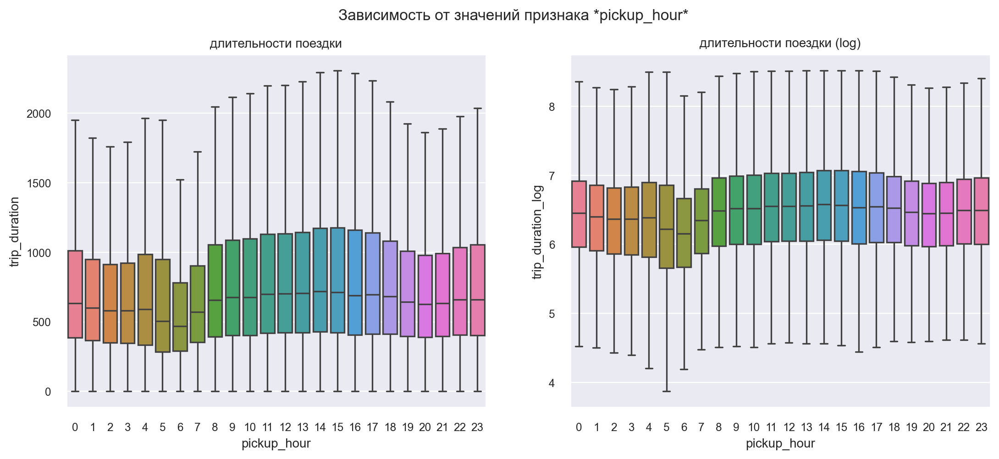

In [89]:
cat_feature_target_visual_version_2(taxi_data, 'pickup_hour', h_size=13)

Визуализируем количество поездок, медианную и среднюю длительность поездки в зависимости от **pickup_hour**.

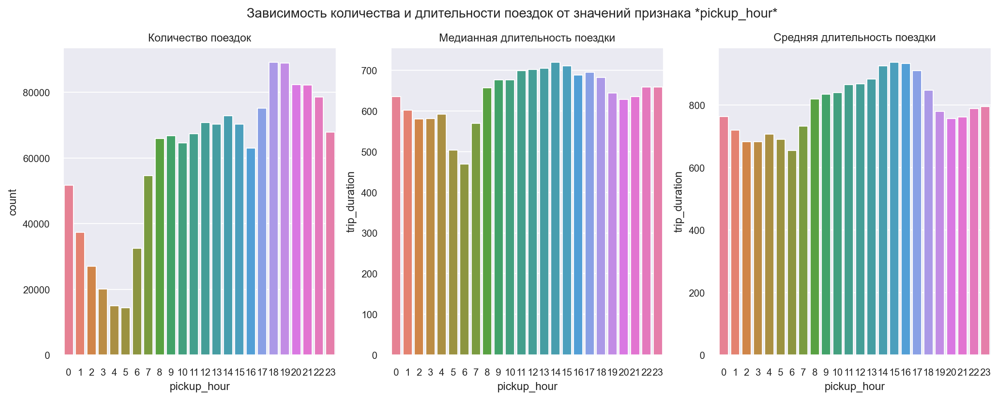

In [90]:
cat_feature_target_visual_version_3(taxi_data, 'pickup_hour', h_size=15)

Расчитаем в виде таблицы количество поездок, медианную и среднюю длительность поездки в зависимости от **pickup_hour**.

In [91]:
feature_median_and_mean_target(taxi_data, 'pickup_hour')

,pickup_hour,count,trip_duration_median,trip_duration_mean
0,0,51646,635.0,763.006138
1,1,37325,602.0,719.918205
2,2,27067,580.0,682.634684
3,3,20101,581.0,683.121287
4,4,14999,592.0,707.345423
5,5,14425,504.0,690.474870
6,6,32538,469.0,654.892894
7,7,54570,570.0,732.176159
8,8,65991,657.0,820.141565
9,9,66768,677.0,835.457704


**Выводы:**
- признак является категориальным.
- минимальное количество поездок отмечается в промежуток 0-7 часов включительно.
- минимальная медианная длительность поездки отмечается в 6 часов, максимальная - 14-15 часов; отметим это, создав новые признаки.
- полагаю целесообразным разделить время начала поездки на 3 временных промежутка: 0-7 часов включительно, 8-18 часов включительно, 19-23 часа включительно, создав новый признак.
- выполним порядковое кодирование признака.

Создаем новые признаки:

In [92]:
# создаем сигнальный признак часа начала поездки = 6
taxi_data['pickup_hour_tdmin'] = taxi_data['pickup_hour'].apply(
    lambda x: 1 if x == 6 else 0
)
# создаем сигнальный признак часа начала поездки = 14 или 15
taxi_data['pickup_hour_tdmax'] = taxi_data['pickup_hour'].apply(
    lambda x: 1 if x in [14,15] else 0
)
# создаем новый признак, где укажем временные промежутки начала поездки
taxi_data['pickup_time_of_day'] = taxi_data['pickup_hour'].apply(
    lambda x: 'night' if x in range(0,8) else 'day' if x in range(8,19) else 'evening'
)

Выполняем порядковое кодирование исходного признака.

In [93]:
# группируем по pickup_hour и сортируем данные в сторону возрастания медианы длительности поездки
groupped = taxi_data.groupby(['pickup_hour']).agg({'trip_duration':'median'}).sort_values(by='trip_duration').reset_index()

# словарь вида час_поездки:порядковый_номер (от 1 до 24) в сторону увеличения медианы длительности поездки
values_pickup_hour = {}
# заполняем словарь
for index, row in groupped.iterrows():
    values_pickup_hour[int(row['pickup_hour'])] = index + 1

# кодируем исходный признак pickup_hour используя порядковое кодирование
taxi_data['pickup_hour'] = taxi_data['pickup_hour'].apply(
    lambda x: values_pickup_hour[x]
)

Выведем сведения о количестве поездок и их длительности в новых созданных признаках.

In [94]:
feature_median_and_mean_target(taxi_data, 'pickup_hour_tdmin')

,pickup_hour_tdmin,count,trip_duration_median,trip_duration_mean
0,0,1396415,661.0,824.820640
1,1,32538,469.0,654.892894


In [95]:
feature_median_and_mean_target(taxi_data, 'pickup_hour_tdmax')

,pickup_hour_tdmax,count,trip_duration_median,trip_duration_mean
0,0,1285780,650.0,808.625132
1,1,143173,716.0,931.647706


In [96]:
feature_median_and_mean_target(taxi_data, 'pickup_time_of_day')

,pickup_time_of_day,count,trip_duration_median,trip_duration_mean
0,day,776356,692.0,878.927845
1,evening,399926,644.0,776.196409
2,night,252671,573.0,713.650510


**Выводы:**
- медианная и средняя длительность поездки в разрезе значений новых признаков отличается, что говорит о том, что признаки будут нам полезны.

Внесем соответствующие изменения в тестовую выборку.

In [97]:
# создаем сигнальный признак часа начала поездки = 6
test_data['pickup_hour_tdmin'] = test_data['pickup_hour'].apply(
    lambda x: 1 if x == 6 else 0
)
# создаем сигнальный признак часа начала поездки = 14 или 15
test_data['pickup_hour_tdmax'] = test_data['pickup_hour'].apply(
    lambda x: 1 if x in [14,15] else 0
)
# создаем новый признак, где укажем временные промежутки начала поездки
test_data['pickup_time_of_day'] = test_data['pickup_hour'].apply(
    lambda x: 'night' if x in range(0,8) else 'day' if x in range(8,19) else 'evening'
)
# кодируем исходный признак pickup_hour используя порядковое кодирование
test_data['pickup_hour'] = test_data['pickup_hour'].apply(
    lambda x: values_pickup_hour[x]
)

***

### 3.7. Признак **passenger_count**

Количество пассажиров.

Визуализируем связь признака **passenger_count** с таргетом.

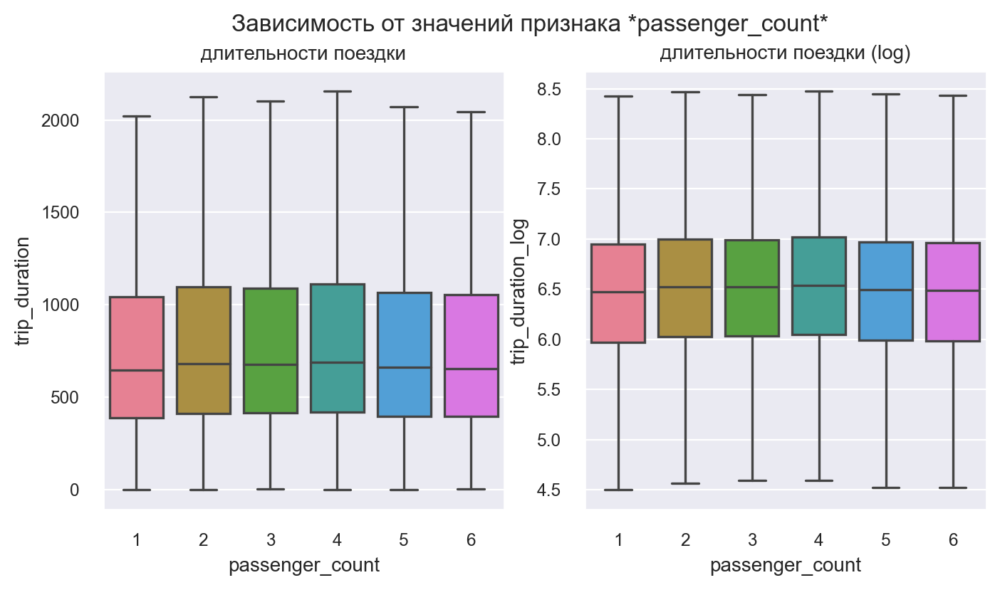

In [98]:
cat_feature_target_visual_version_2(taxi_data, 'passenger_count', h_size=8, v_size=4)

Визуализируем количество поездок, медианную и среднюю длительность поездки в зависимости от **passenger_count**.

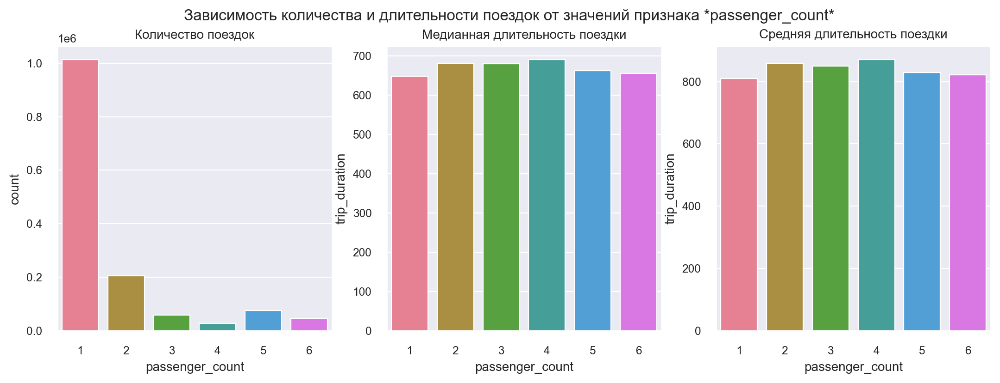

In [99]:
cat_feature_target_visual_version_3(taxi_data, 'passenger_count', h_size=13, v_size=4)

Расчитаем в виде таблицы количество поездок, медианную и среднюю длительность поездки в зависимости от **passenger_count**.

In [100]:
feature_median_and_mean_target(taxi_data, 'passenger_count')

,passenger_count,count,trip_duration_median,trip_duration_mean
0,1,1012919,648.0,809.675203
1,2,205719,681.0,858.416165
2,3,58693,680.0,849.824732
3,4,27782,690.0,869.993089
4,5,76539,662.0,829.453821
5,6,47301,655.0,821.091097


**Выводы:**
- конечно, признак можно считать категориальным и выполнить ему кодирование (OneHot или порядковое), но проблема в том, что в новых данных у нас число пассажиров может превышать 6. Следовательно, тут у нас 2 варианта: число пассажиров более 6 обозначить нулем (т.е. будем считать аномалией) или ничего с признаком не делать. Попробуем закодировать.
- после очистки данных от аномалий и выбросов у нас пропали поездки с количеством пассажиров 7, 8 и 9.
- в подавляющем большинстве поездок перевозили только одного пассажира.
- разница в длительности поездки при количестве пассажиров 1-6 есть, возможно, признак будет полезен.

Выполняем порядковое кодирование признака на обеих выборках.

In [101]:
# группируем по passenger_count и сортируем данные в сторону возрастания медианы длительности поездки
groupped = taxi_data.groupby(['passenger_count']).agg({'trip_duration':'median'}).sort_values(by='trip_duration').reset_index()

# словарь вида количество_пассажиров:порядковый_номер (от 1 до 6) в сторону увеличения медианы длительности поездки
values_passenger_count = {}
# заполняем словарь
for index, row in groupped.iterrows():
    values_passenger_count[int(row['passenger_count'])] = index + 1

# кодируем исходный признак passenger_count используя порядковое кодирование
taxi_data['passenger_count'] = taxi_data['passenger_count'].apply(
    lambda x: values_passenger_count[x] if x in values_passenger_count else 0
)
# кодируем исходный признак passenger_count в тестовой выборке
test_data['passenger_count'] = test_data['passenger_count'].apply(
    lambda x: values_passenger_count[x] if x in values_passenger_count else 0
)

Повторно визуализируем признак.

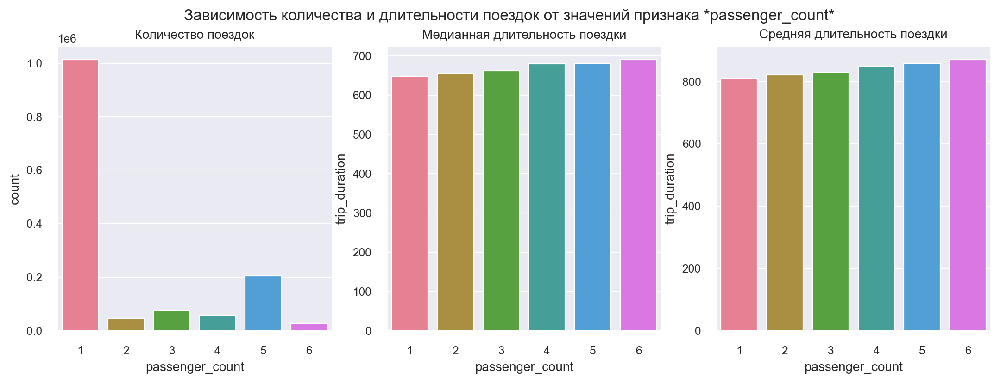

In [102]:
cat_feature_target_visual_version_3(taxi_data, 'passenger_count', h_size=13, v_size=4)

***

### 3.8. Признаки географических координат **pickup_latitude**, **pickup_longitude**, **dropoff_latitude**, **dropoff_longitude**

- **pickup_latitude** и **pickup_longitude** - координаты (широта и долгота, соответственно) включения счетчика (начала поездки)
- **dropoff_latitude** и **dropoff_longitude** - координаты (широта и долгота, соответственно) выключения счетчика (окончания поездки)

Добавим в рабочую таблицу еще признаки на основе координат:
- **geo_cluster_trip** - географический кластер поездки
- **geo_cluster_pickup** - географический кластер включения счетчика
- **geo_cluster_dropoff** - географический кластер выключения счетчика

In [103]:
# используем функцию add_cluster_features для выполнения кластеризации и сохраняем обученные алгоритмы
taxi_data, kmeans_trip, kmeans_pickup, kmeans_dropoff = add_cluster_features(taxi_data)

Визуализируем полученые кластеры включения счетчика.

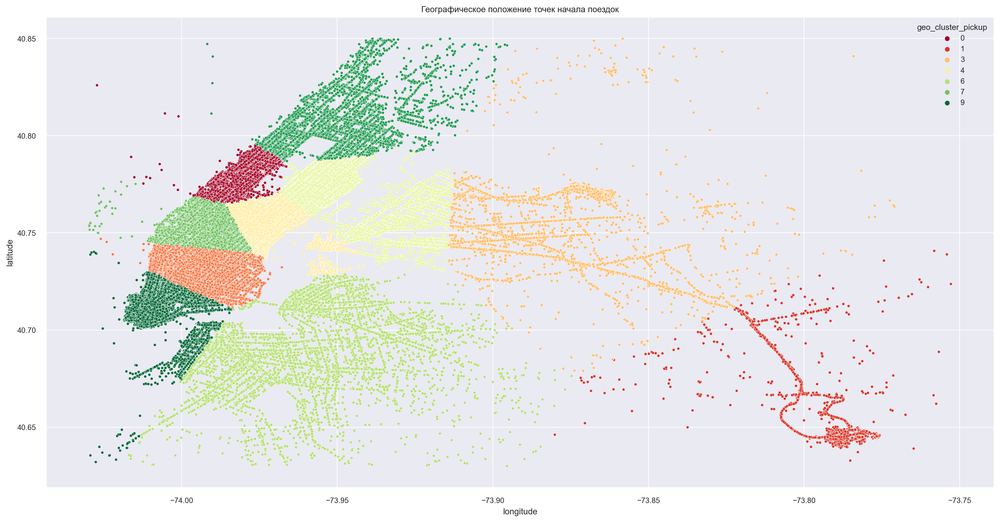

In [104]:
# визуализируем кластеры
fig = plt.figure(figsize = (20, 10))
scatter = sns.scatterplot(
    data = taxi_data,
    x = 'pickup_longitude',
    y = 'pickup_latitude',
    hue = 'geo_cluster_pickup',
    palette = 'RdYlGn',
    s = 10
)
scatter.set_title('Географическое положение точек начала поездок');
scatter.set_xlabel('longitude');
scatter.set_ylabel('latitude');

Визуализируем кластеры выключения счетчика.

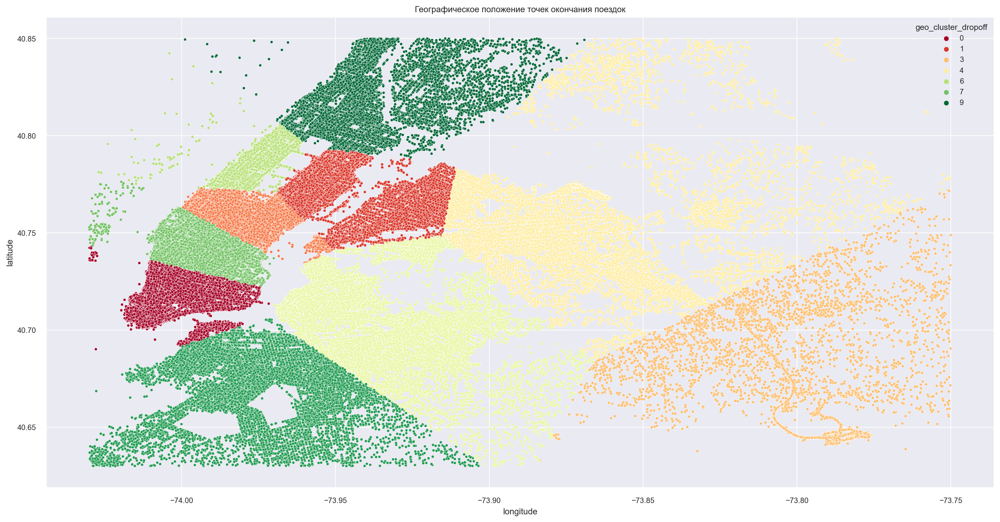

In [105]:
# визуализируем кластеры
fig = plt.figure(figsize = (20, 10))
scatter = sns.scatterplot(
    data = taxi_data,
    x = 'dropoff_longitude',
    y = 'dropoff_latitude',
    hue = 'geo_cluster_dropoff',
    palette = 'RdYlGn',
    s = 10
)
scatter.set_title('Географическое положение точек окончания поездок');
scatter.set_xlabel('longitude');
scatter.set_ylabel('latitude');

Визуализируем взаимосвязь новых признаков с таргетом.

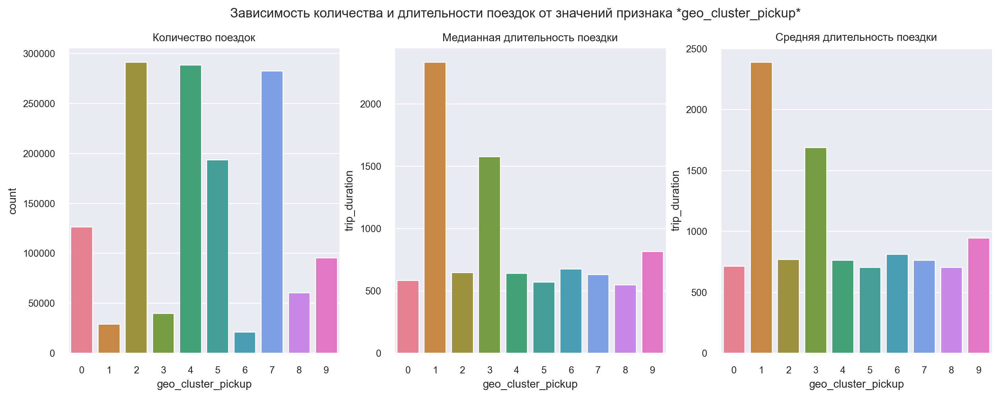

In [106]:
cat_feature_target_visual_version_3(taxi_data, 'geo_cluster_pickup')

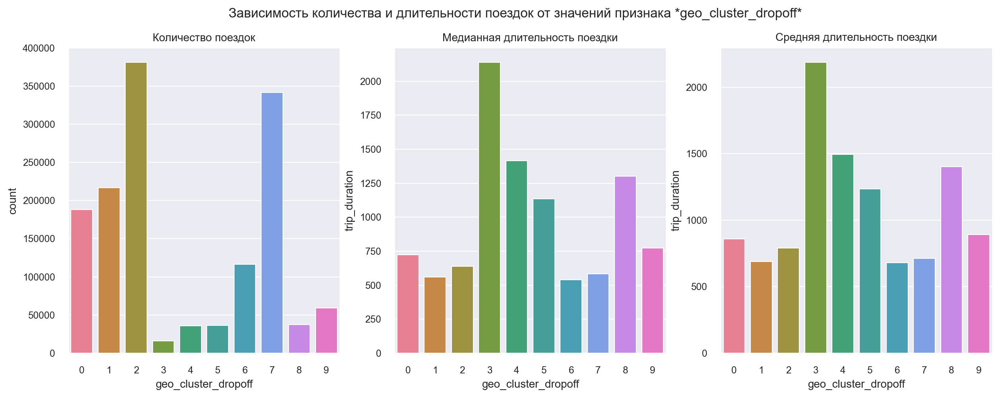

In [107]:
cat_feature_target_visual_version_3(taxi_data, 'geo_cluster_dropoff')

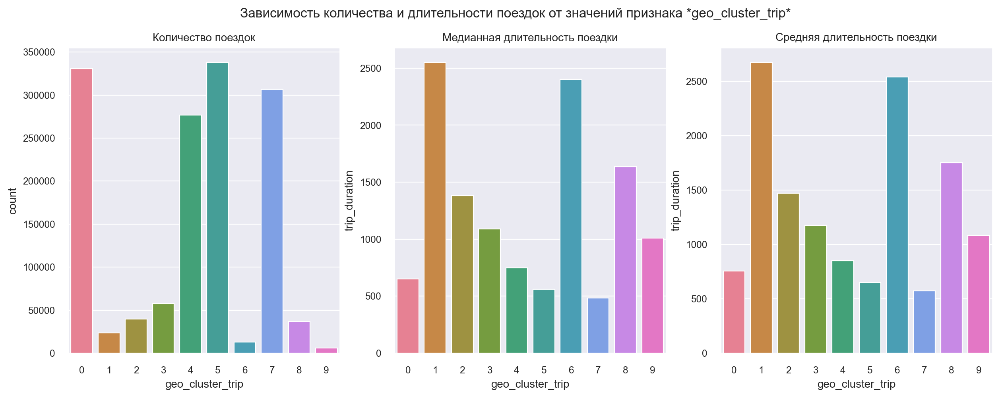

In [108]:
cat_feature_target_visual_version_3(taxi_data, 'geo_cluster_trip')

**Выводы:**
- исходные признаки с координатами - непрерывные числовые, оставляем без изменений.
- были созданы новые признаки с кластерами поездок, координат включения и выключения счетчика.
- кластеры в признаках различаются по количеству поездок и их длительности.
- теоретически, данные признаки должны быть полезны для обучения модели.
- новые признаки являются категориальными, выполним порядковое кодирование, как выше.

Выделим с помощью обученных на тренировочных даных алгоритмах кластеры на тестовой выборке.

In [109]:
# используем функцию для выделения кластеров
test_data = add_cluster_features_for_test(test_data, kmeans_trip, kmeans_pickup, kmeans_dropoff)

Выполним порядковое кодирование на обеих выборках.

In [110]:
# список с признаками для кодирования
features_for_ordinal_encoding = ['geo_cluster_pickup', 'geo_cluster_dropoff', 'geo_cluster_trip']

for feature in features_for_ordinal_encoding:
    # группируем по признаку и сортируем данные в сторону возрастания медианы длительности поездки на обучающей выборке
    groupped = taxi_data.groupby([feature]).agg({'trip_duration':'median'}).sort_values(by='trip_duration').reset_index()

    # словарь вида значение_признака:порядковый_номер (от 1 до 10) в сторону увеличения медианы длительности поездки
    values_feature = {}
    # заполняем словарь
    for index, row in groupped.iterrows():
        values_feature[int(row[feature])] = index + 1

    # на тренировочных данных кодируем исходный признак feature используя порядковое кодирование
    taxi_data[feature] = taxi_data[feature].apply(
        lambda x: values_feature[x]
    )
    # на тестовых данных кодируем исходный признак feature используя порядковое кодирование
    test_data[feature] = test_data[feature].apply(
        lambda x: values_feature[x]
    )

Повторно визуализируем закодированные признаки.

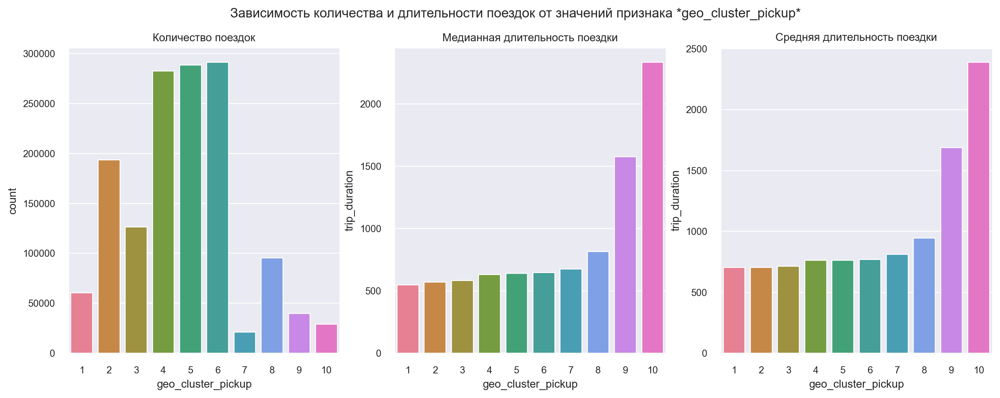

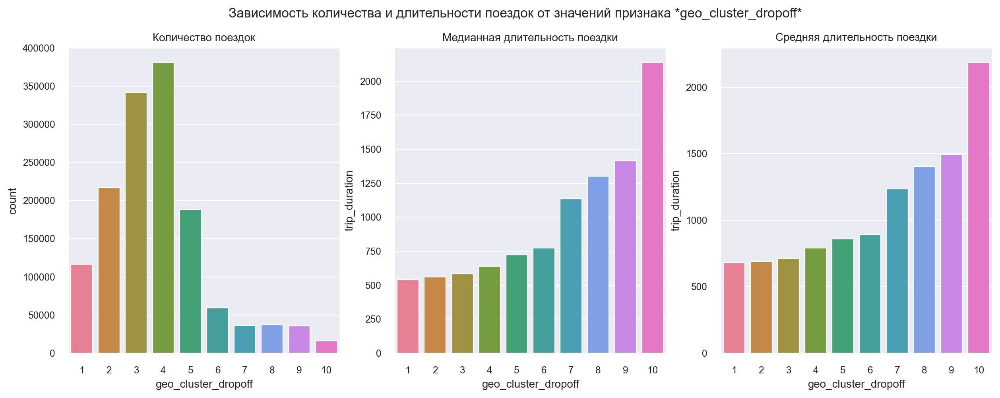

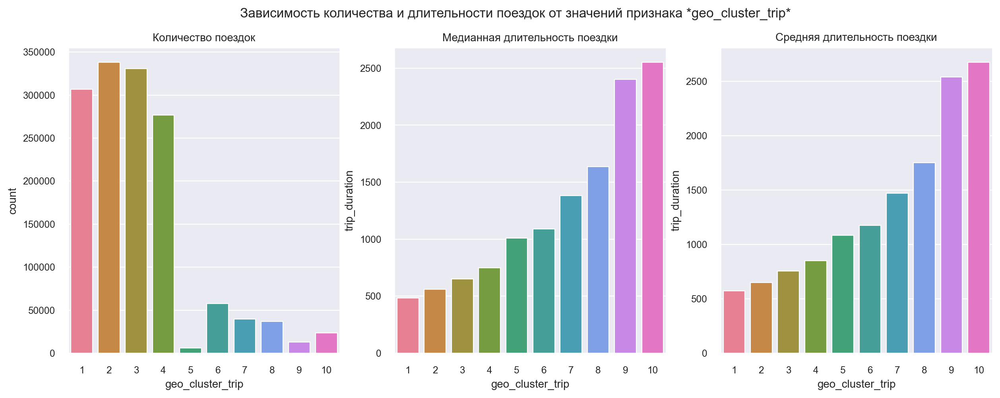

In [111]:
for feature in features_for_ordinal_encoding:
    cat_feature_target_visual_version_3(taxi_data, feature)

***

### 3.9. Признаки **total_travel_time** и **total_distance**

- **total_travel_time** - наименьшее время поездки (в секундах) из точки, в которой был включён счётчик, до точки, в которой счётчик был выключен (согласно OSRM);
- **total_distance** - кратчайшее дорожное расстояние (в метрах) из точки, в которой был включён счётчик, до точки, в которой счётчик был выключен (согласно OSRM);

Визуализируем признаки.

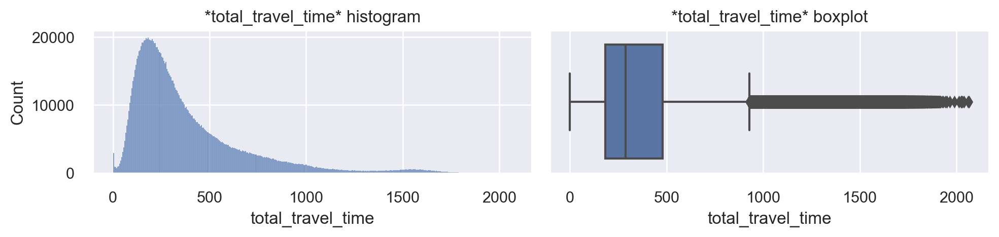

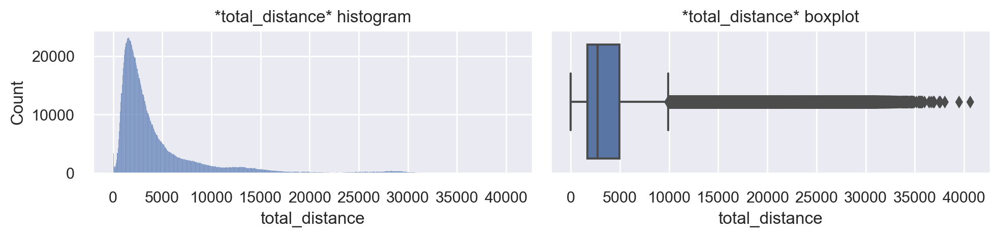

In [112]:
sns.set(rc={'figure.figsize':(10,2.5)})
num_features_visual(taxi_data, 'total_travel_time')
num_features_visual(taxi_data, 'total_distance')

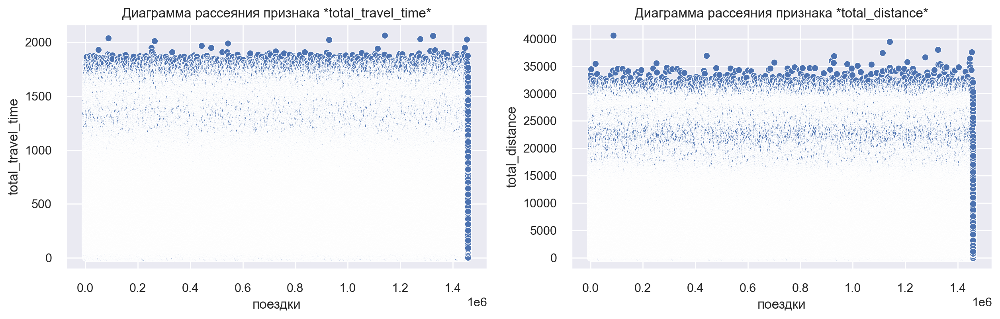

In [113]:
fig = plt.figure(figsize=(15, 4))
plt.subplot(1,2,1)
num_features_visual_scatter(taxi_data, 'total_travel_time')
plt.subplot(1,2,2)
num_features_visual_scatter(taxi_data, 'total_distance')
plt.show();

**Выводы:**
- поездки чаще укладываются в 5км по расстоянию и в 500сек по времени (теоретически).
- признаки содержат выбросы (пока не трогаем).
- пробовал создать новый признак **total_average_speed**, как отношение признаков **total_distance** и **total_travel_time**, однако получил некоторое количество пустых и бесконечных значений. Пробовал заменить их нулями, однако результат моделирования не сильно обнадежил. Удалил.
- созданный выше признак **average_speed** помог нам очистить данные, однако содержит в себе информацию о целевой переменной (признак **trip_duration**), поэтому удаляем.

In [114]:
# удаляем признак average_speed
taxi_data.drop('average_speed', axis=1, inplace=True)

***

### 3.10. Признак **number_of_steps**

Количество дискретных шагов, которые должен выполнить водитель (поворот налево/поворот направо/ехать прямо и т. д.). Банальная логика говорит о том, что значения признака могут быть только целыми.

In [115]:
# изменим тип данных
taxi_data['number_of_steps'] = taxi_data['number_of_steps'].astype(int)

Визуализируем признак **number_of_steps** как категориальный.

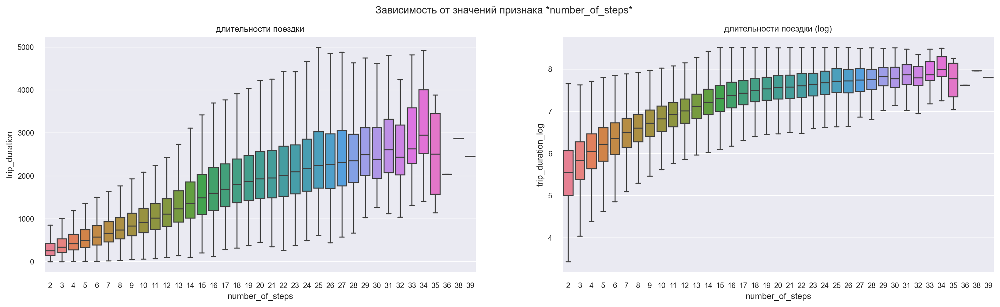

In [116]:
cat_feature_target_visual_version_2(taxi_data, 'number_of_steps', h_size=20)

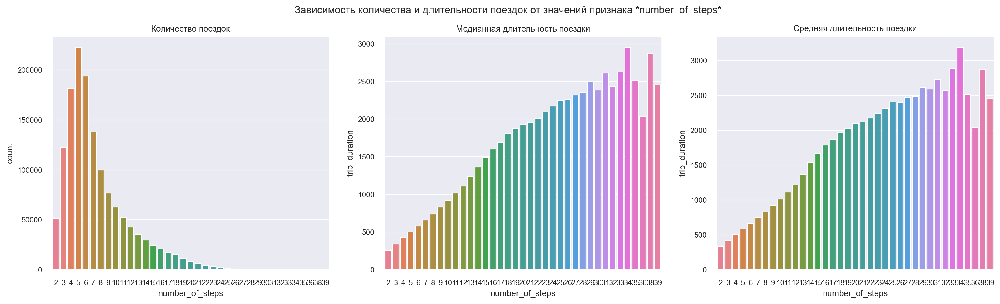

In [117]:
cat_feature_target_visual_version_3(taxi_data, 'number_of_steps', h_size=20)

Визуализируем признак **number_of_steps** как числовой.

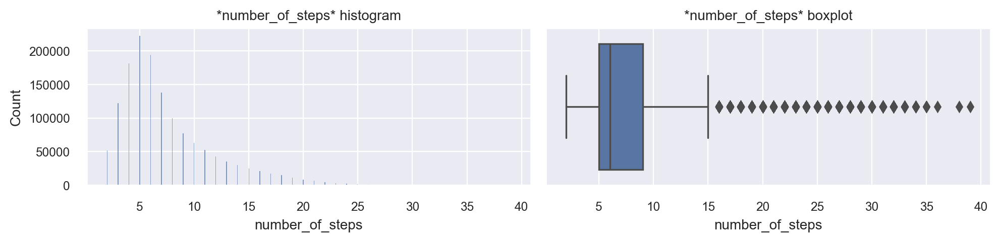

In [118]:
num_features_visual(taxi_data, 'number_of_steps')

**Выводы:**
- думаю, что признак нужно воспринимать как дискретный числовой.
- чаще в поездках такси осуществляли 2-11 маневров, самый частый вариант - 5 маневров.
- видна четкая связь с таргетом: с увеличением числа маневров растет длительность поездки, что верно для промежутка 2-29 маневров (если оцениваем медиану), дальше зависимость нарушается (хотя при этом сильно падает количество таких поездок).
- в принципе, даже если представлять данный признак как категориальный, то в этом случае можно считать, что порядковое кодирование уже выполнено.

Применяем изменения на тестовой выборке.

In [119]:
# изменим тип данных
test_data['number_of_steps'] = test_data['number_of_steps'].astype(int)

***

### 3.11. Признак **haversine_distance**

Расстояние Хаверсина между точкой, в которой был включён счетчик, и точкой, в которой счётчик был выключен (км).

Визуализируем признак **haversine_distance**.

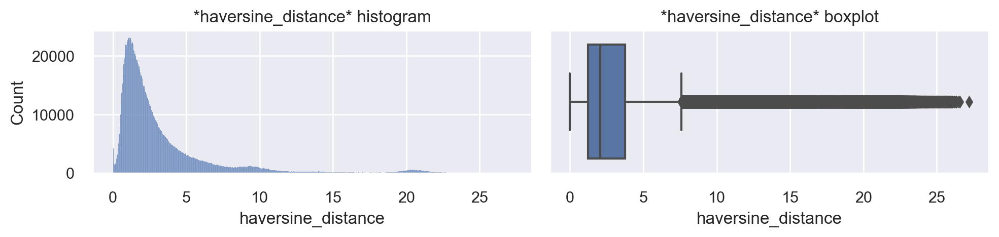

In [120]:
sns.set(rc={'figure.figsize':(10,2.5)})
num_features_visual(taxi_data, 'haversine_distance')

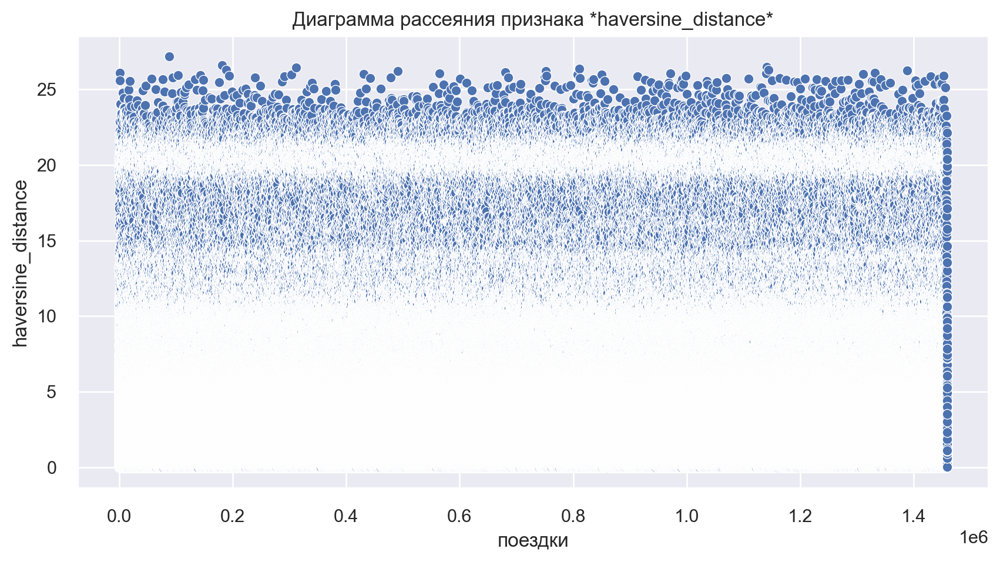

In [121]:
sns.set(rc={'figure.figsize':(10,5)})
num_features_visual_scatter(taxi_data, 'haversine_distance')

**Выводы:**
- расстояния довольно короткие: 2-4км в основном.
- есть выбросы, но визуально их меньше, чем в похожем признаке **total_distance**
- ради интереса, я попробовал создать признак **total_haversine_ratio**, как отношение **total_distance** к **haversine_distance**, однако новый признак содержал большое количество выбросов - удалил.

***

### 3.11. Признак **direction**

Направление движения из точки, в которой был включён счётчик, в точку, в которой счётчик был выключен.

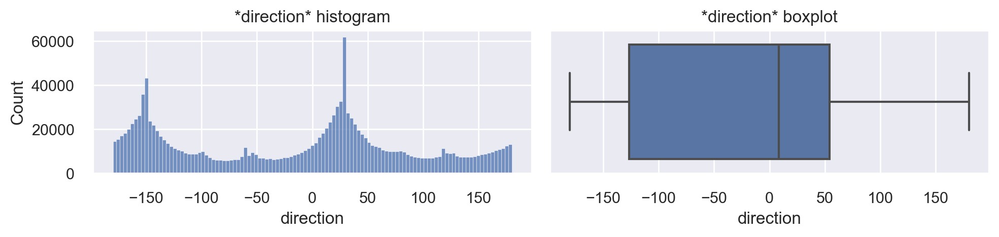

In [122]:
sns.set(rc={'figure.figsize':(10,2.5)})
num_features_visual(taxi_data, 'direction')

**Выводы:**
- распределение признака очень неравномерно.
- признак, вероятнее всего, не будет важен для решения задачи регрессии; об этом нам, кстати, говорит корреляция Спирмена (признак в 4-ке худших).
- попробуем разбить признак на группы по значениям и выделить новый категориальный признак.

In [123]:
print(f'Минимальное значение признака *direction* {taxi_data.direction.min()}')
print(f'Максимальное значение признака *direction* {taxi_data.direction.max()}')

Минимальное значение признака *direction* -179.9917872693874
Максимальное значение признака *direction* 180.0


Создадим новый признак **direction_group**.

In [124]:
# для создания категорий используем метод cut()
taxi_data['direction_group'] = pd.cut(
    taxi_data.direction, [-180,-120,-60,0,60,120,181], 
    labels = ['-180-120','-120-60','-60-0','0-60','60-120', '120-180']
)

Визуализируем полученный признак **direction_group**.

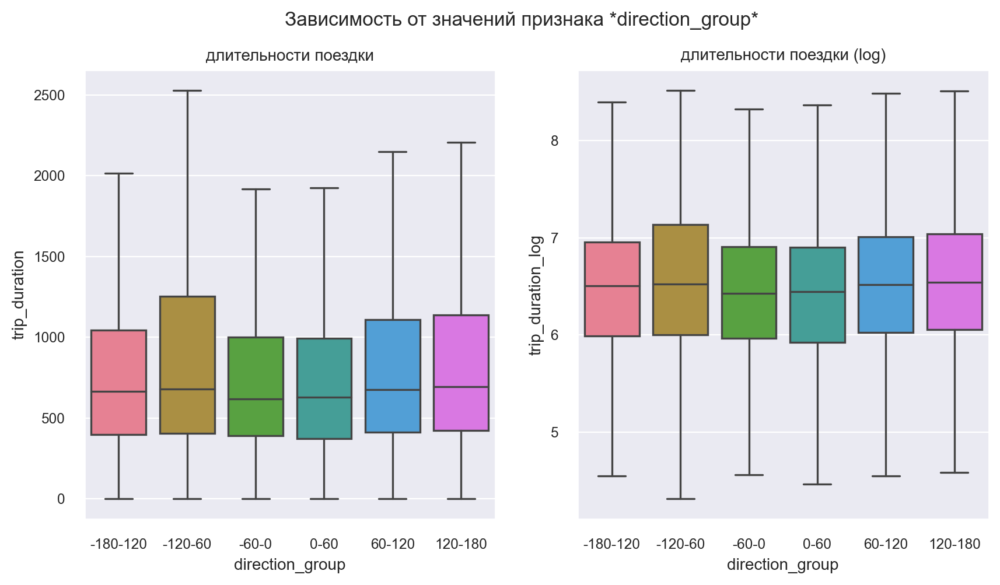

In [125]:
cat_feature_target_visual_version_2(taxi_data, 'direction_group')

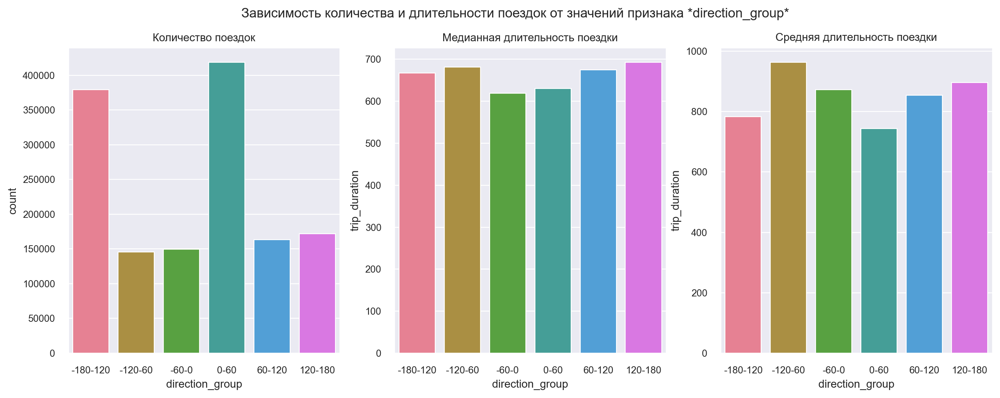

In [126]:
cat_feature_target_visual_version_3(taxi_data, 'direction_group')

In [127]:
feature_median_and_mean_target(taxi_data, 'direction_group')

,direction_group,count,trip_duration_median,trip_duration_mean
0,-180-120,379254,667.0,782.726271
1,-120-60,145513,681.0,963.797489
2,-60-0,149972,619.0,872.612221
3,0-60,419021,630.0,743.644452
4,60-120,163456,675.0,854.059655
5,120-180,171737,693.0,896.326761


**Выводы:**
- получен новый категориальный признак **direction_group** в котором 6 значений.
- длительность поездки различается в разрезе значений данного признака.
- надеюсь, это поможет улучшить нашу модель.

Повторим манипуляции на тестовой выборке.

In [128]:
# для создания категорий используем метод cut()
test_data['direction_group'] = pd.cut(
    test_data.direction, [-180,-120,-60,0,60,120,181], 
    labels = ['-180-120','-120-60','-60-0','0-60','60-120', '120-180']
)

***

### 3.12. Признаки **left**, **none**, **right**, **sharp left**,**sharp right**, **slight left**, **slight right**, **straight**, **uturn**

Данные признаки извлечены из признака **step_direction** в данных OSRM и означают маневры (направления маневров) которые делает автомобиль при движении из начальной в конечную точку.

In [129]:
# изменим тип признаков с float на int
for feature in new_features_from_step_direction:
    taxi_data[feature] = taxi_data[feature].astype(int)

Визуализируем корреляцию Спирмена данных признаков с таргетом (добавим в сравнение признак **number_of_steps**).

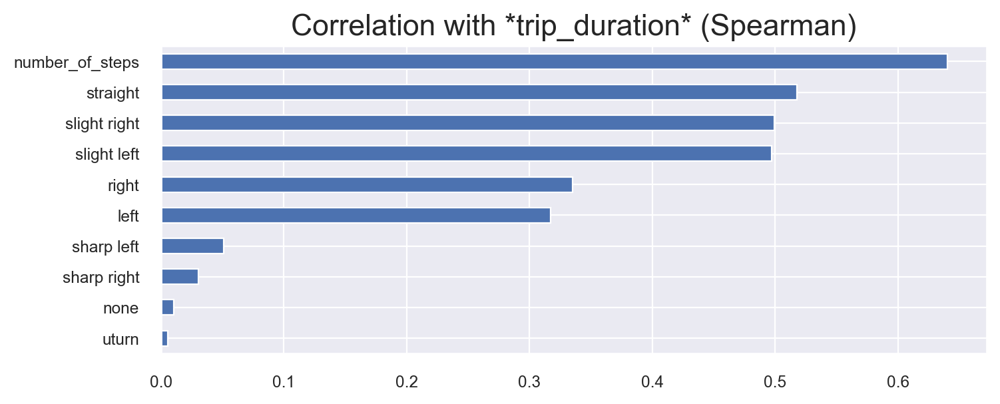

In [130]:
# визуализируем корреляцию Спирмена данных признаков с таргетом

columns = list(new_features_from_step_direction)
columns.extend(['number_of_steps', 'trip_duration'])

taxi_data[columns].corr(method='spearman')["trip_duration"].apply(lambda x: abs(x)).sort_values()[:-1].plot.barh(figsize=(8, 3))
plt.title("Correlation with *trip_duration* (Spearman)", fontsize = 16)
plt.show();

Добавим новые признаки. Можно удалить признаки со степенью корреляции менее 0.1 (4 нижних), но пока не трогаем.

In [131]:
# добавляем новые признаки
taxi_data['nos_sr_diff'] = taxi_data['number_of_steps'] - taxi_data['slight right'] 
taxi_data['nos_sl_diff'] = taxi_data['number_of_steps'] - taxi_data['slight left'] 
taxi_data['nos_r_diff'] = taxi_data['number_of_steps'] - taxi_data['right'] 
taxi_data['nos_l_diff'] = taxi_data['number_of_steps'] - taxi_data['left']

Повторно выведем корреляцию Спирмена с добавленными новыми признаками, убрав признаки с низкой корреляцией.

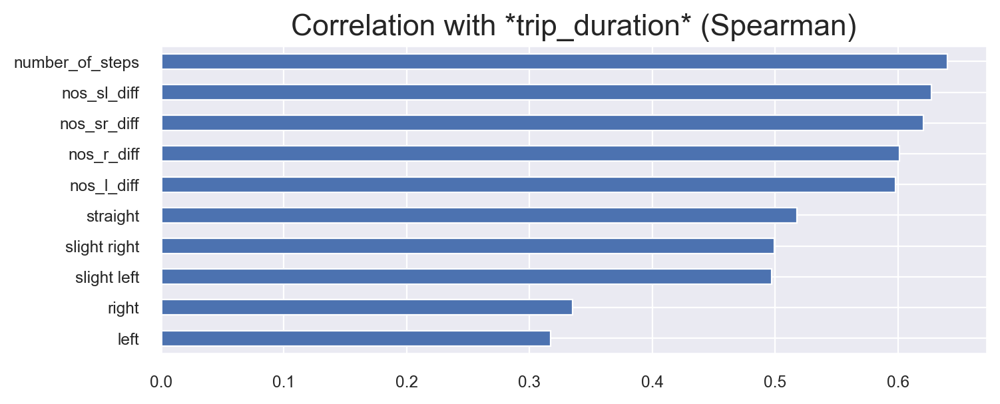

In [132]:
# визуализируем корреляцию Спирмена новых признаков с таргетом

columns = list(set(columns) - {'none', 'sharp left', 'sharp right', 'none', 'uturn'})
columns.extend(['nos_sr_diff', 'nos_sl_diff', 'nos_r_diff', 'nos_l_diff'])

taxi_data[columns].corr(method='spearman')["trip_duration"].apply(lambda x: abs(x)).sort_values()[:-1].plot.barh(figsize=(8, 3))
plt.title("Correlation with *trip_duration* (Spearman)", fontsize = 16)
plt.show();

**Выводы:**
- созданые новые признаки имеют высокую степень корреляции с целевой переменной.

Повторим данные манипуляции с тестовой выборкой.

In [133]:
# повторим данные манипуляции с тестовой выборкой

# изменим тип признаков с float на int
for feature in new_features_from_step_direction:
    test_data[feature] = test_data[feature].astype(int)

# добавляем новые признаки
test_data['nos_sr_diff'] = test_data['number_of_steps'] - test_data['slight right'] 
test_data['nos_sl_diff'] = test_data['number_of_steps'] - test_data['slight left'] 
test_data['nos_r_diff'] = test_data['number_of_steps'] - test_data['right'] 
test_data['nos_l_diff'] = test_data['number_of_steps'] - test_data['left']

***

### 3.13. Признаки **continue**, **end of road**, **fork**, **merge**, **new name**, **off ramp**, **on ramp**, **rotary**, **roundabout**, **roundabout turn**, **turn**

Данные признаки извлечены из признака **step_maneuvers** в данных OSRM и означают, насколько я понял, собственно какие маневры делает автомобиль при движении из начальной в конечную точку.

In [134]:
# изменим тип признаков с float на int
for feature in new_features_from_step_maneuvers:
    taxi_data[feature] = taxi_data[feature].astype(int)

Визуализируем корреляцию Спирмена данных признаков с таргетом.

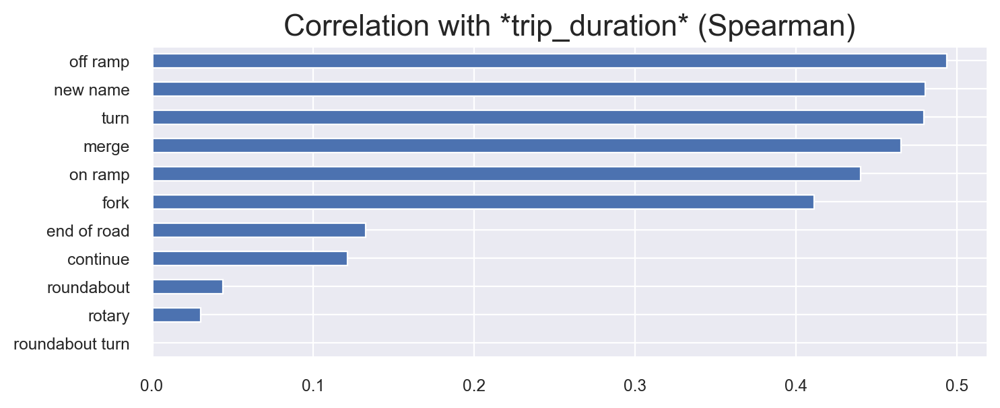

In [135]:
# визуализируем корреляцию Спирмена данных признаков с таргетом

columns = list(new_features_from_step_maneuvers)
columns.extend(['trip_duration'])

taxi_data[columns].corr(method='spearman')["trip_duration"].apply(lambda x: abs(x)).sort_values()[:-1].plot.barh(figsize=(8, 3))
plt.title("Correlation with *trip_duration* (Spearman)", fontsize = 16)
plt.show();

**Выводы:**
- 6 признаков имеют степень корреляции выше 0.4 - оставляем.
- 5 признаков имеют степень корреляции менее 0.2 - можно удалить, но пока оставим.

Повторим данные манипуляции с тестовой выборкой.

In [136]:
# повторим данные манипуляции с тестовой выборкой

# изменим тип признаков с float на int
for feature in new_features_from_step_maneuvers:
    test_data[feature] = test_data[feature].astype(int)

***

### 3.14. Признаки **temperature**, **visibility**, **wind speed**, **precip**, **events**

Признаки погодных условий на момент начала поездки:
- **temperature** - температура
- **visibility** - видимость
- **wind speed** - скорость ветра
- **precip** - осадки
- **events** - события

Визуализируем корреляцию данных признаков с таргетом.

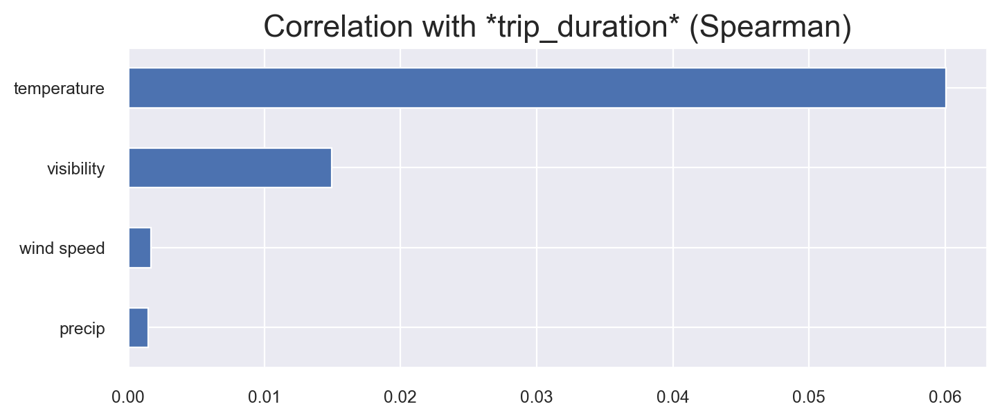

In [137]:
# визуализируем корреляцию Спирмена данных признаков с таргетом

columns = ['temperature', 'visibility', 'wind speed', 'precip']
columns.extend(['trip_duration'])

taxi_data[columns].corr(method='spearman')["trip_duration"].apply(lambda x: abs(x)).sort_values()[:-1].plot.barh(figsize=(8, 3))
plt.title("Correlation with *trip_duration* (Spearman)", fontsize = 16)
plt.show();

К сожалению, данные признаки не слишком сильно коррелируют с целевой переменной.

In [138]:
# выберем признаки погодных условий, которые будем визуализировать как категориальные
weather_features_cat = ['visibility', 'precip', 'wind speed', 'events']

#### 3.14.1 Признаки **visibility**, **precip**, **events**, **wind speed**

Визуализируем вышеперечисленные категориальные признаки.

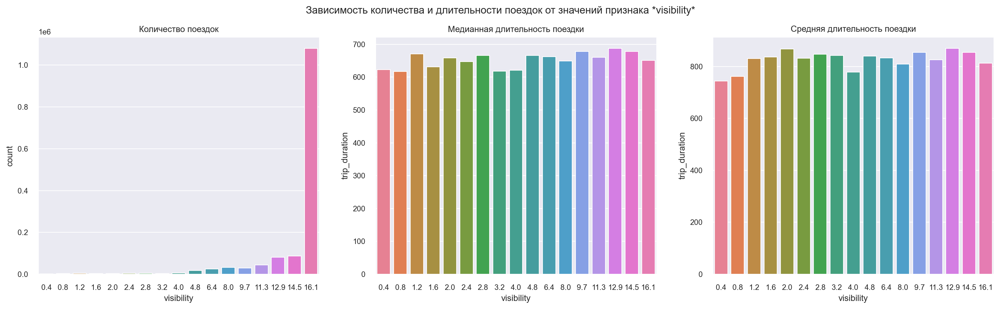

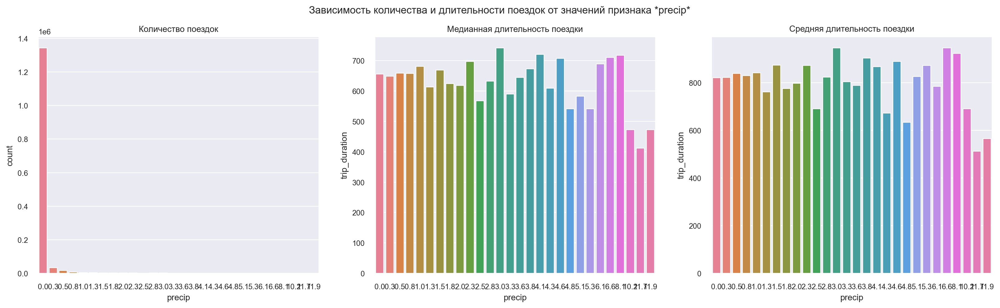

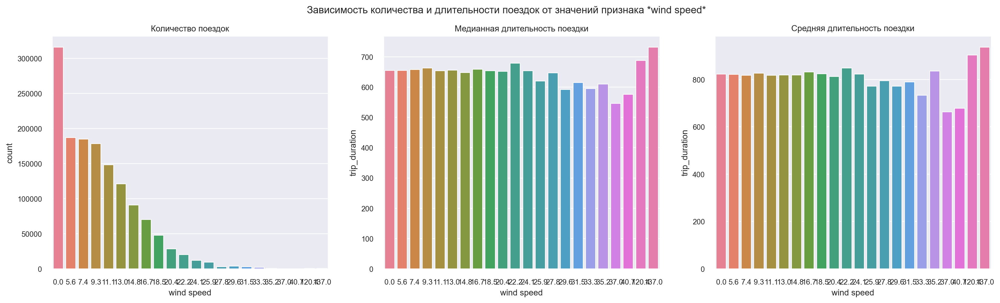

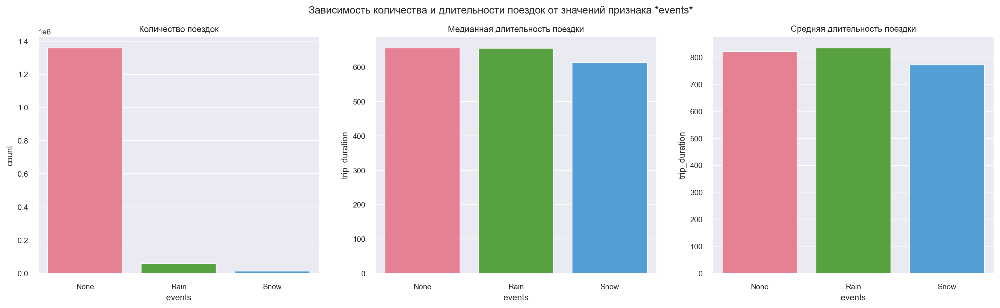

In [139]:
for feature in weather_features_cat:
    cat_feature_target_visual_version_3(taxi_data, feature, h_size=20)

Уточним признак **wind speed**.

,wind speed,count,trip_duration_median,trip_duration_mean
0,0.0,315944,655.0,822.421382
1,5.6,187067,655.0,821.216532
2,7.4,184903,658.0,817.793113
3,9.3,178527,663.0,826.636117
4,11.1,148293,654.0,817.276675
5,13.0,120944,655.5,818.255102
6,14.8,90876,648.0,818.178452
7,16.7,70161,659.0,831.199755
8,18.5,47817,654.0,823.657904
9,20.4,28558,652.0,812.089432


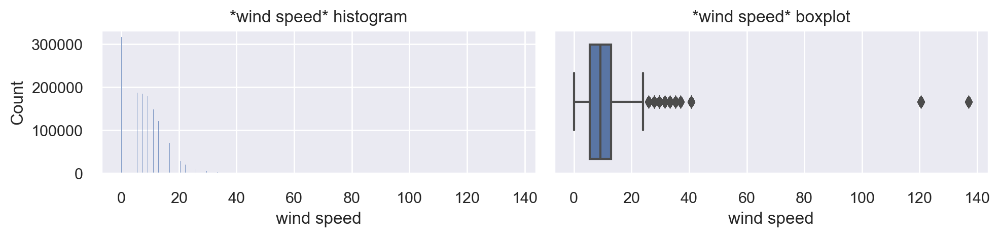

In [140]:
sns.set(rc={'figure.figsize':(10,2.5)})
num_features_visual(taxi_data, 'wind speed')
feature_median_and_mean_target(taxi_data, 'wind speed')

Уточним признак **events**.

In [141]:
feature_median_and_mean_target(taxi_data, 'events')

,events,count,trip_duration_median,trip_duration_mean
0,None,1358945,656.0,820.849131
1,Rain,57148,655.0,834.442238
2,Snow,12860,613.0,771.795645


Странно... признак **events**: при событии *snow* длительность поездки меньше - интересно почему? По идее, должно быть наоборот...

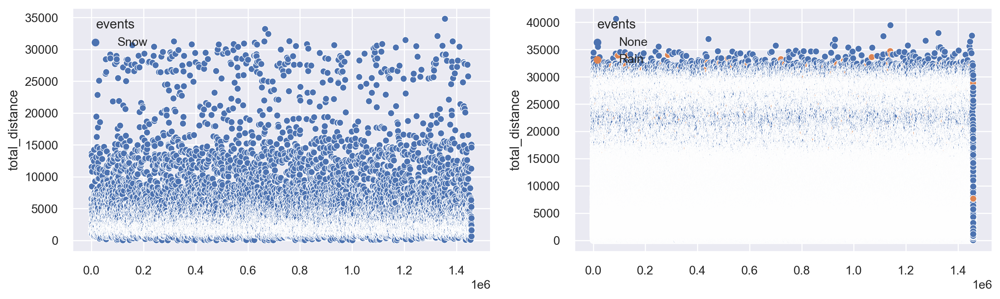

In [142]:
# создадим маски по значению Snow признака events
mask_1 = taxi_data['events'] == 'Snow'
mask_2 = taxi_data['events'] != 'Snow'
# визуализируем разделенные по маскам данные
fig = plt.figure(figsize=(15, 4))
plt.subplot(1,2,1)
sns.scatterplot(data=taxi_data[mask_1], x=taxi_data[mask_1].index, y='total_distance', hue='events', legend=True);
plt.subplot(1,2,2)
sns.scatterplot(data=taxi_data[mask_2], x=taxi_data[mask_2].index, y='total_distance', hue='events');
plt.show();

In [143]:
# сгруппируем данные и оценим total_distance в разрезе признака events
taxi_data.groupby('events').agg({'total_distance':'mean'})

,total_distance
events,
None,4448.250961
Rain,4250.783429
Snow,4216.990054


**Выводы:**
- в подавляющем большинстве поездки осуществлялись в условиях хорошей видимости, без осадков и без погодных событий, ветер отсутствовал или был небольшим.
- признак **events**: при событии *snow* длительность поездки меньше, вероятная причина - это поездки на более короткие расстояния.
- честно говоря, по представленным диаграммам не определяется какая-то связь с целевой переменной, что и подтверждается корреляцией.
- складывается впечатление, что эти признаки не сильно нам помогут, но попробуем пока их оставить.
- признаку **events** выполним OneHotEncoding.

#### 3.14.2 Непрерывный числовой признак **temperature**

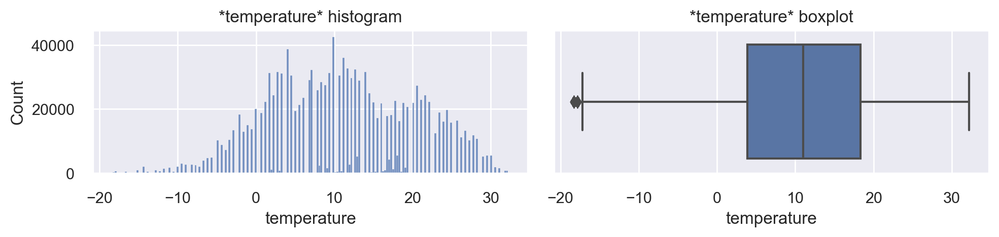

In [144]:
sns.set(rc={'figure.figsize':(10,2.5)})
num_features_visual(taxi_data, 'temperature')

Данные в признаке импеют распределение близкое к нормальному. Оставляем признак без изменений.

***

### 3.15. Создание дополнительных признаков

Проанализируем взаимосвязь пар категориальных признаков и целевой переменной, создадим новые признаки.    
Критерии создания новых признаков:
- выбираем минимальные и максимальные значения медианы длительности поездки (будем учитывать и средние значения)
- достаточное количество наблюдений в отобранных группах

In [145]:
# выберем признаки для создания пар
features_for_pairs = ['passenger_count',
 'pickup_day_of_week','pickup_month',
 'pickup_time_of_day',
 'direction_group', 'events']

In [146]:
# создаем необходимые уникальные комбинации отобраных признаков
# в виде списка из кортежей
features_pair = combinantorial(features_for_pairs)
print(f'Всего создано {len(features_pair)} пар признаков')

Всего создано 15 пар признаков


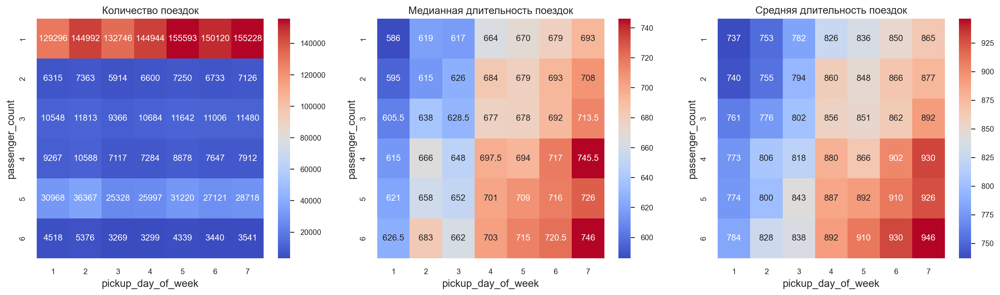

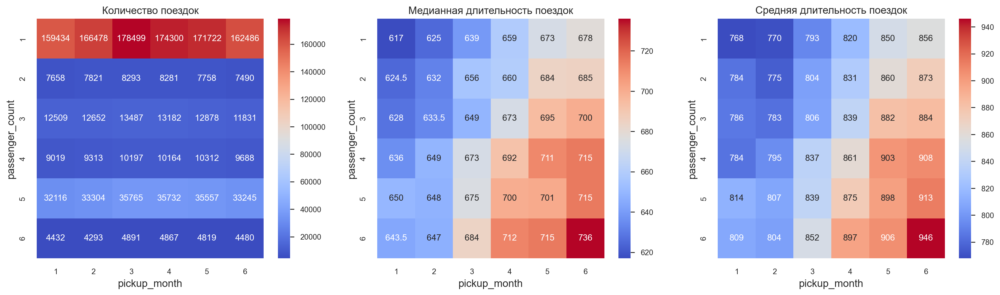

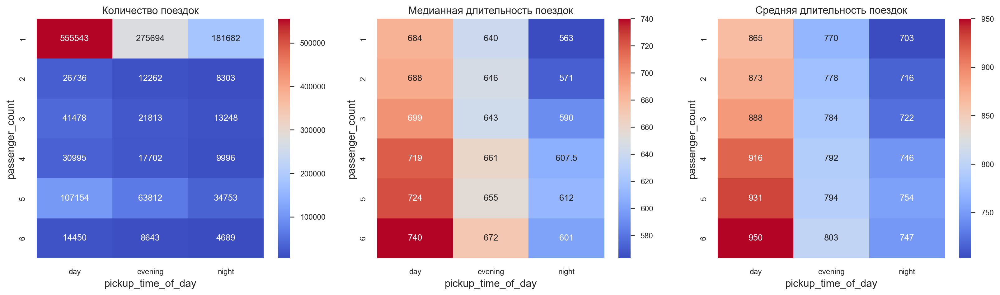

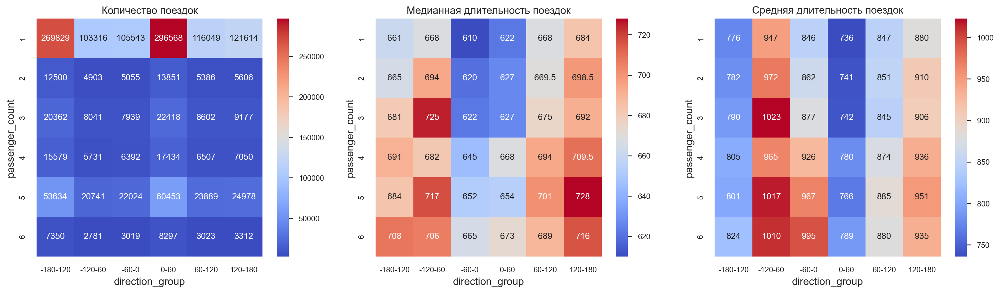

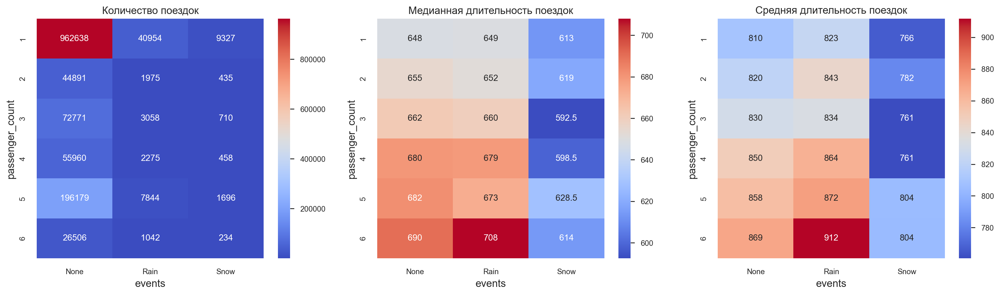

In [147]:
# визуализируем взаимосвязь категориальных признаков
for pair in features_pair[:5]: # первые 5 пар
    heatmap_cat_features(taxi_data, pair[0], pair[1])

In [148]:
# создадим признак pc_pdow_tdmax
taxi_data['pc_pdow_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] in [3,4]) & (row['pickup_day_of_week'] == 3)) else 0,
    axis=1
)
# создадим признак pc_pdow_tdmin
taxi_data['pc_pdow_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 1) & (row['pickup_day_of_week'] == 6)) else 0,
    axis=1
)

# создадим признак pc_pm_tdmax
taxi_data['pc_pm_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 4) & (row['pickup_month'] == 6)) else 0,
    axis=1
)
# создадим признак pc_pm_tdmin
taxi_data['pc_pm_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 1) & (row['pickup_month'] == 1)) else 0,
    axis=1
)

# создадим признак pc_ptod_tdmax
taxi_data['pc_ptod_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 4) & (row['pickup_time_of_day'] == 'day')) else 0,
    axis=1
)
# создадим признак pc_ptod_tdmin
taxi_data['pc_ptod_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 1) & (row['pickup_time_of_day'] == 'night')) else 0,
    axis=1
)

# создадим признак pc_dg_tdmax
taxi_data['pc_dg_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 5) & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)

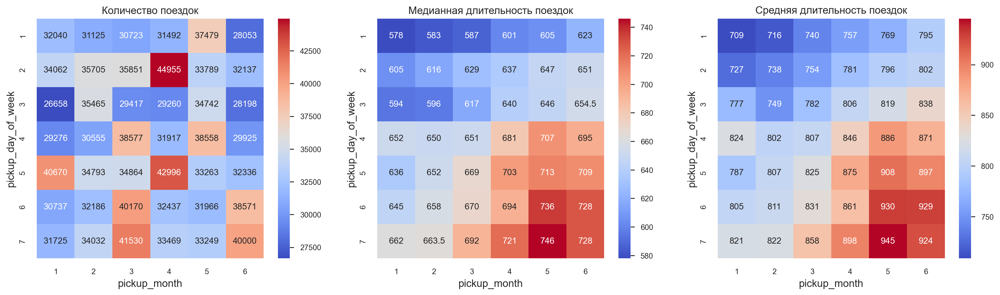

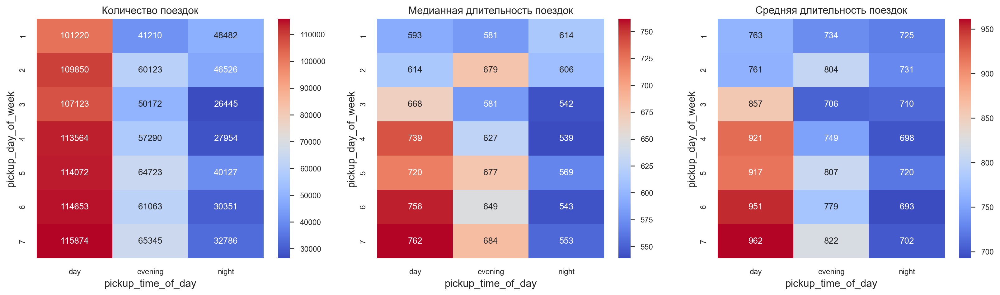

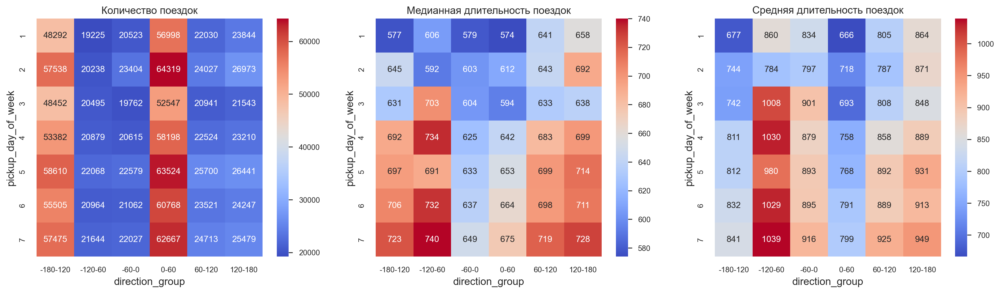

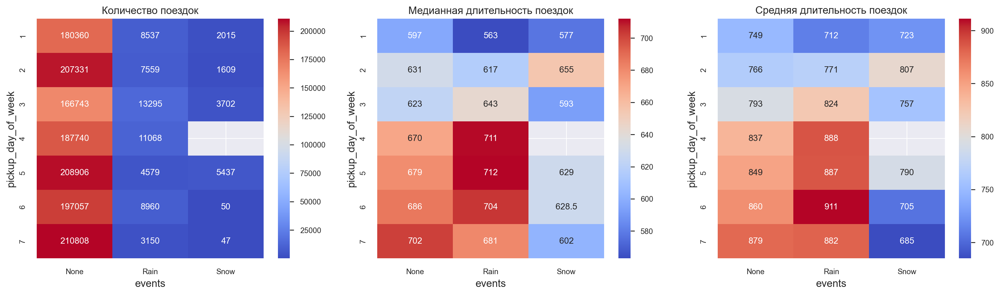

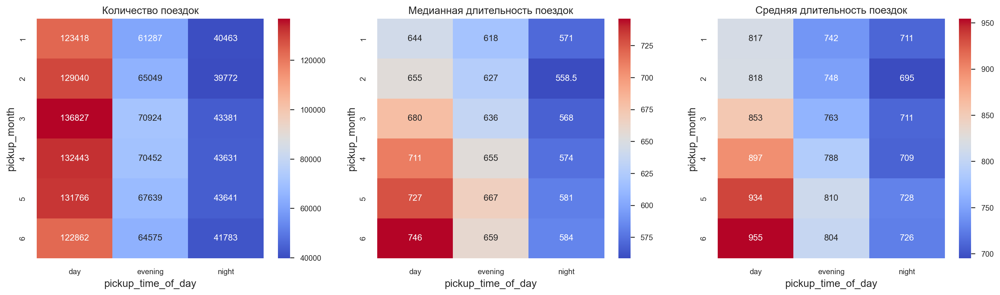

In [149]:
# визуализируем взаимосвязь категориальных признаков
for pair in features_pair[5:10]: # еще 5 пар
    heatmap_cat_features(taxi_data, pair[0], pair[1])

In [150]:
# создадим признак pdow_pm_tdmax
taxi_data['pdow_pm_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [2,3]) & (row['pickup_month'] == 5)) else 0,
    axis=1
)
# создадим признак pdow_pm_tdmin
taxi_data['pdow_pm_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] == 6) & (row['pickup_month'] in [1,2])) else 0,
    axis=1
)

# создадим признак pdow_ptod_tdmax
taxi_data['pdow_ptod_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [2,3]) & (row['pickup_time_of_day'] == 'day')) else 0,
    axis=1
)
# создадим признак pdow_ptod_tdmin
taxi_data['pdow_ptod_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [1,2]) & (row['pickup_time_of_day'] == 'night')) else 0,
    axis=1
)

# создадим признак pdow_dg_tdmax
taxi_data['pdow_dg_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [1,2,3]) & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)
# создадим признак pdow_dg_tdmin
taxi_data['pdow_dg_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] == 6) & (row['direction_group'] in ['-180-120','0-60'])) else 0,
    axis=1
)

# создадим признак pdow_events_tdmax
taxi_data['pdow_events_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [1,4]) & (row['events'] == 'Rain')) else 0,
    axis=1
)
# создадим признак pdow_events_tdmin
taxi_data['pdow_events_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] == 6) & (row['events'] == 'Rain')) else 0,
    axis=1
)

# создадим признак pm_ptod_tdmax
taxi_data['pm_ptod_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 6) & (row['pickup_time_of_day'] == 'day')) else 0,
    axis=1
)

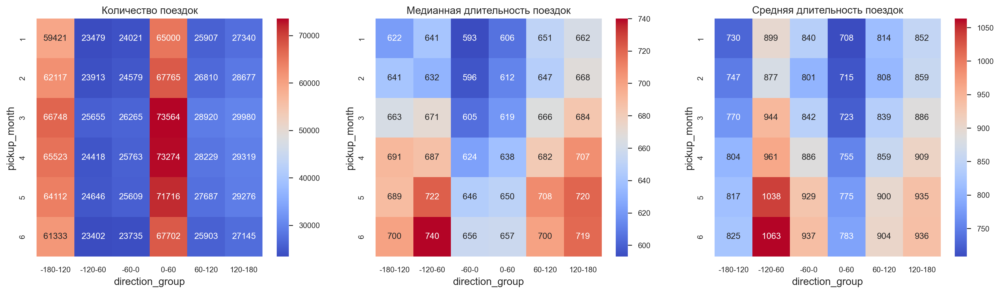

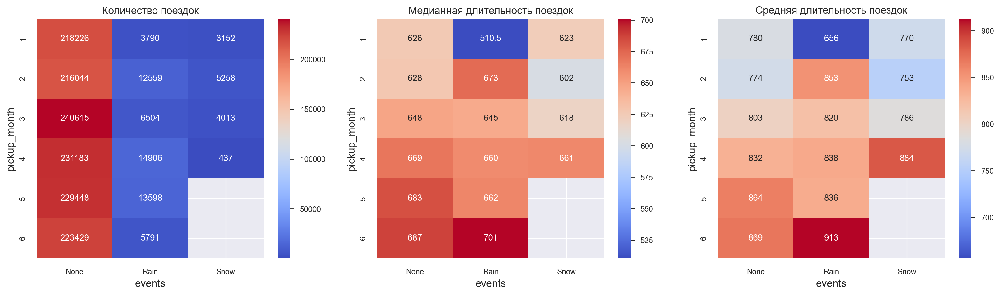

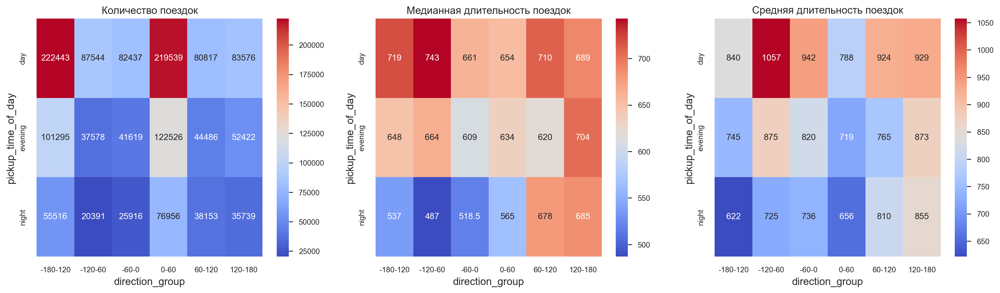

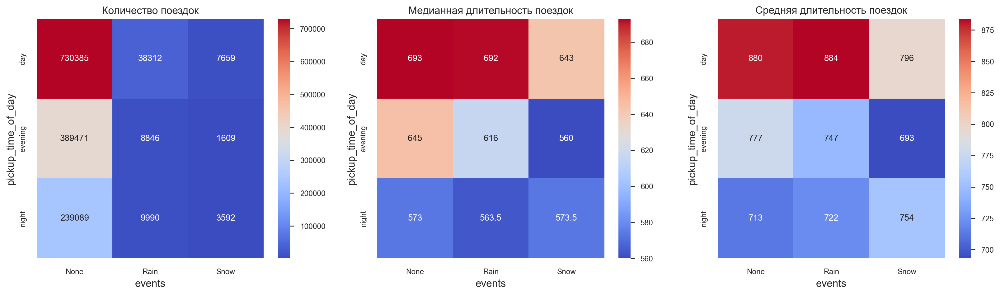

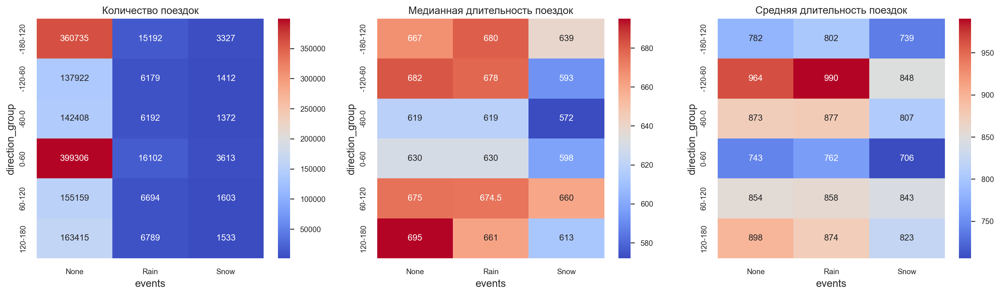

In [151]:
# визуализируем взаимосвязь категориальных признаков
for pair in features_pair[10:]: # последние пары
    heatmap_cat_features(taxi_data, pair[0], pair[1])

In [152]:
# создадим признак pm_dg_tdmax
taxi_data['pm_dg_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 6) & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)

# создадим признак pm_events_tdmax
taxi_data['pm_events_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 6) & (row['events'] == 'Rain')) else 0,
    axis=1
)
# создадим признак pm_events_tdmin
taxi_data['pm_events_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 1) & (row['events'] == 'Rain')) else 0,
    axis=1
)

# создадим признак ptod_dg_tdmax
taxi_data['ptod_dg_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_time_of_day'] == 'day') & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)

# создадим признак ptod_events_tdmax
taxi_data['ptod_events_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_time_of_day'] == 'day') & (row['events'] in ['None','Rain'])) else 0,
    axis=1
)
# создадим признак ptod_events_tdmin
taxi_data['ptod_events_tdmin'] = taxi_data.apply(
    lambda row: 1 if ((row['pickup_time_of_day'] == 'evening') & (row['events'] == 'Snow')) else 0,
    axis=1
)

# создадим признак dg_events_tdmax
taxi_data['dg_events_tdmax'] = taxi_data.apply(
    lambda row: 1 if ((row['direction_group'] == '120-180') & (row['events'] == 'None')) else 0,
    axis=1
)

Повторим для тестовой выборки.

In [153]:
# создадим признак pc_pdow_tdmax
test_data['pc_pdow_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] in [3,4]) & (row['pickup_day_of_week'] == 3)) else 0,
    axis=1
)
# создадим признак pc_pdow_tdmin
test_data['pc_pdow_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 1) & (row['pickup_day_of_week'] == 6)) else 0,
    axis=1
)

# создадим признак pc_pm_tdmax
test_data['pc_pm_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 4) & (row['pickup_month'] == 6)) else 0,
    axis=1
)
# создадим признак pc_pm_tdmin
test_data['pc_pm_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 1) & (row['pickup_month'] == 1)) else 0,
    axis=1
)

# создадим признак pc_ptod_tdmax
test_data['pc_ptod_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 4) & (row['pickup_time_of_day'] == 'day')) else 0,
    axis=1
)
# создадим признак pc_ptod_tdmin
test_data['pc_ptod_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 1) & (row['pickup_time_of_day'] == 'night')) else 0,
    axis=1
)

# создадим признак pc_dg_tdmax
test_data['pc_dg_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['passenger_count'] == 5) & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)

# создадим признак pdow_pm_tdmax
test_data['pdow_pm_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [2,3]) & (row['pickup_month'] == 5)) else 0,
    axis=1
)
# создадим признак pdow_pm_tdmin
test_data['pdow_pm_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] == 6) & (row['pickup_month'] in [1,2])) else 0,
    axis=1
)

# создадим признак pdow_ptod_tdmax
test_data['pdow_ptod_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [2,3]) & (row['pickup_time_of_day'] == 'day')) else 0,
    axis=1
)
# создадим признак pdow_ptod_tdmin
test_data['pdow_ptod_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [1,2]) & (row['pickup_time_of_day'] == 'night')) else 0,
    axis=1
)

# создадим признак pdow_dg_tdmax
test_data['pdow_dg_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [1,2,3]) & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)
# создадим признак pdow_dg_tdmin
test_data['pdow_dg_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] == 6) & (row['direction_group'] in ['-180-120','0-60'])) else 0,
    axis=1
)

# создадим признак pdow_events_tdmax
test_data['pdow_events_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] in [1,4]) & (row['events'] == 'Rain')) else 0,
    axis=1
)
# создадим признак pdow_events_tdmin
test_data['pdow_events_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['pickup_day_of_week'] == 6) & (row['events'] == 'Rain')) else 0,
    axis=1
)

# создадим признак pm_ptod_tdmax
test_data['pm_ptod_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 6) & (row['pickup_time_of_day'] == 'day')) else 0,
    axis=1
)

# создадим признак pm_dg_tdmax
test_data['pm_dg_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 6) & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)

# создадим признак pm_events_tdmax
test_data['pm_events_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 6) & (row['events'] == 'Rain')) else 0,
    axis=1
)
# создадим признак pm_events_tdmin
test_data['pm_events_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['pickup_month'] == 1) & (row['events'] == 'Rain')) else 0,
    axis=1
)

# создадим признак ptod_dg_tdmax
test_data['ptod_dg_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_time_of_day'] == 'day') & (row['direction_group'] == '-120-60')) else 0,
    axis=1
)

# создадим признак ptod_events_tdmax
test_data['ptod_events_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['pickup_time_of_day'] == 'day') & (row['events'] in ['None','Rain'])) else 0,
    axis=1
)
# создадим признак ptod_events_tdmin
test_data['ptod_events_tdmin'] = test_data.apply(
    lambda row: 1 if ((row['pickup_time_of_day'] == 'evening') & (row['events'] == 'Snow')) else 0,
    axis=1
)

# создадим признак dg_events_tdmax
test_data['dg_events_tdmax'] = test_data.apply(
    lambda row: 1 if ((row['direction_group'] == '120-180') & (row['events'] == 'None')) else 0,
    axis=1
)

***

### 3.16. Удалим ненужные признаки

In [154]:
list_for_del = [
    'pickup_longitude',
    'pickup_latitude',
    'dropoff_longitude',
    'dropoff_latitude',
    'direction',
    'pickup_date'
]

In [155]:
taxi_data.drop('id', axis=1, inplace=True)
taxi_data.drop(list_for_del, axis=1, inplace=True)

In [156]:
test_data.drop(list_for_del, axis=1, inplace=True)

***

### 3.17. Проверка на наличие пропусков и бесконечных значений

Обучающая выборка:

In [157]:
# если в таблице бесконечные значения - заменим их на NaN
taxi_data = taxi_data.replace([np.inf, -np.inf], np.nan)

# ищем пропуски
print(f'Всего пропусков: {taxi_data.isnull().sum().sum()}\n')
print(f'Столбцы с пропусками:\n {taxi_data.loc[:, taxi_data.columns[taxi_data.isna().any()]].isna().sum()}')

Всего пропусков: 0

Столбцы с пропусками:
 Series([], dtype: float64)


Тестовая выборка:

In [158]:
# если в таблице бесконечные значения - заменим их на NaN
test_data = test_data.replace([np.inf, -np.inf], np.nan)

# ищем пропуски
print(f'Всего пропусков: {test_data.isnull().sum().sum()}\n')
print(f'Столбцы с пропусками:\n {test_data.loc[:, test_data.columns[test_data.isna().any()]].isna().sum()}')

Всего пропусков: 0

Столбцы с пропусками:
 Series([], dtype: float64)


***

### 3.18. Итоговая размерность данных

In [159]:
print(f'Размерность начального датасета: {initial_shape}')
print(f'Размерность итогового датасета: {taxi_data.shape}')
data_loss = (initial_shape[0] - taxi_data.shape[0])/ initial_shape[0] * 100
print(f'Исходный датасет уменьшился на {data_loss:.2f}% (на {initial_shape[0] - taxi_data.shape[0]} наблюдений)')


Размерность начального датасета: (1458644, 11)
Размерность итогового датасета: (1428953, 73)
Исходный датасет уменьшился на 2.04% (на 29691 наблюдений)


In [160]:
print(f'Размерность обучающей выборки (с учетом 2-х таргетов) {taxi_data.shape}')
print(f'Размерность тестовой выборки {test_data.shape}')

Размерность обучающей выборки (с учетом 2-х таргетов) (1428953, 73)
Размерность тестовой выборки (625134, 72)


In [161]:
taxi_data_columns = set(taxi_data.columns.to_list())
test_data_columns = set(test_data.columns.to_list())
print(f'Разница в признаках между taxi_data и test_data: {taxi_data_columns - test_data_columns}')
print(f'Разница в признаках между test_data и taxi_data: {test_data_columns - taxi_data_columns}') 


Разница в признаках между taxi_data и test_data: {'trip_duration_log', 'trip_duration'}
Разница в признаках между test_data и taxi_data: {'id'}


***
***

## 4. Подготовка и сохранение обработанных данных

In [162]:
# выделим id из тестовых данных
test_id = test_data[['id']]

In [163]:
# выделим целевые переменные
y_data = taxi_data[['trip_duration', 'trip_duration_log']]

# выделим матрицу наблюдений для обучающих данных
X_data = taxi_data.drop(['trip_duration', 'trip_duration_log'], axis=1)
# зафиксируем порядок столбцов в обучающих данных
list_of_clolumns = X_data.columns.to_list()

In [164]:
# скорректируем порядок столбцов в тестовых данных
test_data = test_data.reindex(columns=list_of_clolumns)

In [165]:
y_data.to_csv('data/y_data.csv', index=False)
X_data.to_csv('data/X_data.csv', index=False)
test_data.to_csv('data/test_data.csv', index=False)
test_id.to_csv('data/test_id.csv', index=False)

***
***

## 5. Выводы

- данные были исследованы и очищены
- были подгружены дополнительные данные с новыми признаками
- выполнены EDA и FE
- обработанные и подготовленные данные сохранены
- на следующем этапе будут выполнены:
    - дополнительная обработка данных
    - подготовка данных к моделированию
    - моделирование